# CONTEXTE

Mission - Segmentez des clients d'un site e-commerce


Comment allez vous procéder ?
Barres titres

 

Cette mission suit un scénario de projet professionnel.


Vous pouvez suivre les étapes pour vous aider à réaliser vos livrables.

 

Avant de démarrer, nous vous conseillons de :

lire toute la mission et ses documents liés ;
prendre des notes sur ce que vous avez compris ;
consulter les étapes pour vous guider ; 
préparer une liste de questions pour votre première session de mentorat.
 

Prêt à mener la mission ?
Barres titres

 

Vous êtes consultant pour Olist, une entreprise brésilienne qui propose une solution de vente sur les marketplaces en ligne.

 

La page d'accueil du site Olist
Votre rôle est d’accompagner Olist dans leur projet de monter une équipe Data et leur premier cas d’usage Data Science autour de la segmentation client.

 

Vous venez de rejoindre Olist dans un contexte de recrutement intensif afin de monter leur équipe Data. En effet, ils font d’abord appel à des consultants comme vous en renfort sur les sujets les plus critiques en attendant d'internaliser les compétences. Avant de réaliser la segmentation client, on vous attribue une première mission pour aider Fernanda, Lead Data Analyst chez Olist. 

 

De : Fernanda

A : Moi

Objet : dashboard Customer Experience

Bonjour,

 

Bienvenue chez Olist ! Nous sommes ravis d’avoir du soutien en cette période de mise en place de notre écosystème Data.

 

A ce sujet d’ailleurs, l’un de nos projets Data phares du moment est la construction et la maintenance de notre Dashboard au service des équipes Customer Experience. Nous y exposons les KPIs essentiels pour que les équipes puissent avoir de la visibilité sur les états, les villes, ou les vendeurs qui nécessitent un suivi de près de la part de notre service client.

 

Nous sommes en train d’alimenter les résultats de ce Dashboard avec des requêtes qui interrogent la base de données SQL à laquelle tu as accès.

 

C’est sur l’implémentation de certaines requêtes urgentes que tu peux nous filer un coup de main le temps qu’un nouveau Data Analyst rejoigne l’équipe pour prendre le relais.

 

Je mets en PJ la liste de requêtes SQL que nous avons besoin d’intégrer au Dashboard. 

 

Cordialement,

Fernanda

Lead Data Analyst chez Olist

Pieces jointes:

Liste de requêtes SQL
Après avoir étudié les éléments partagés par Fernanda vous vous mettez au travail.

 

Quelques jours plus tard
Barres titres

 

Cette urgence résolue, vous pouvez enfin passer à votre mission principale : Olist souhaite que vous fournissiez à ses équipes d'e-commerce une segmentation des clients qu’elles pourront utiliser au quotidien pour leurs campagnes de communication.

 

Votre objectif est de comprendre les différents types d’utilisateurs grâce à leur comportement et à leurs données personnelles.

 

Vous devrez fournir à l’équipe Marketing une description actionable de votre segmentation et de sa logique sous-jacente pour une utilisation optimale, ainsi qu’une proposition de contrat de maintenance basée sur une analyse de la stabilité des segments au cours du temps.

 

Les données
Pour cette mission, Olist vous fournit une base de données anonymisée comportant des informations sur l’historique des commandes, les produits achetés, les commentaires de satisfaction, et la localisation des clients depuis janvier 2017.

 

Vous devez aider les équipes d’Olist à comprendre les différents types d'utilisateurs. Vous utiliserez donc des méthodes non supervisées pour regrouper des clients de profils similaires. Ces catégories pourront être utilisées par l’équipe Marketing pour mieux communiquer.

 

Vous créez donc un notebook et démarrez votre travail d’analyse exploratoire.

 
3 jours plus tard
Barres titres

 

Après quelques premières analyses, vous vous rendez compte qu'Olist ne vous a pas fourni beaucoup de données ; vous enquêtez donc auprès de l'entreprise pour obtenir quelques informations complémentaires, et vérifier que vous avez bien compris la mission.

 

Voici sa réponse :


De : João

A : Moi

Objet : re : segmentation des clients

Bonjour, 

 

Nous sommes confiants sur le fait que les données à disposition suffiront pour réaliser un premier clustering. Cela a déjà été fait par d’autres prestataires par le passé, avec encore moins de données.

 

La segmentation proposée doit être exploitable et facile d’utilisation par notre équipe Marketing. Elle doit au minimum pouvoir différencier les bons et moins bons clients en termes de commandes et de satisfaction. Nous attendons bien sûr une segmentation sur l’ensemble des clients.

 

Dans un deuxième temps, une fois le modèle de segmentation choisi, nous souhaiterions que vous nous fassiez une recommandation de fréquence à laquelle la segmentation doit être mise à jour pour rester pertinente, afin de pouvoir effectuer un devis de contrat de maintenance.


Pour information, le code fourni doit respecter la convention PEP8, pour être utilisable par Olist.

 

À titre d'exemple, je joins à cet e-mail la segmentation RFM réalisée par votre prédécesseur il y a quelques années. Mais c’est uniquement à titre d’exemple, j'attends un travail plus approfondi de votre part dans le cadre de ce projet (i.e. RFM, satisfaction et autres possibilités).

 

Bien à vous,

João de l’équipe Marketing

Pièce-jointe :

Schéma RFM, comparant récence, fréquence et montant et classant les clients en groupes.


Vous réalisez trois autres documents afin de préparer une réponse à Olist : 

Un notebook avec des essais des différentes approches de modélisation 
Un notebook de simulation pour déterminer la fréquence nécessaire de mise à jour du modèle de segmentation, afin que celui-ci reste pertinent 
Une présentation pour un collègue afin d’obtenir ses retours sur votre approche
 

C’est parti pour cette dernière ligne droite ! 

 

 

# LIVRABLES

* Un script avec l’ensemble des requêtes SQL demandées par Fernanda
* Un notebook de l'analyse exploratoire (non cleané, pour comprendre votre démarche)
* Un notebook (ou code commenté au choix) d’essais des différentes approches de modélisation (non cleané, pour comprendre votre démarche)
* Un notebook de simulation pour déterminer la fréquence nécessaire de mise à jour du modèle de segmentation
* Un support de présentation pour présenter votre travail à un collègue

# IMPORTS

In [2]:
# data & science
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.metrics import *
from sklearn.base import clone
from sklearn import metrics
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans, DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import category_encoders as ce
from sklearn.decomposition import PCA
from sklearn.datasets import load_digits
from sklearn.model_selection import GridSearchCV, ParameterGrid
from collections import Counter
# graphiques
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from mpl_toolkits.mplot3d import Axes3D
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import silhouette_visualizer
# system & tools
import sqlite3
from datetime import datetime, timedelta
import pickle
import os
from importlib import reload
import warnings
import locale
import time
# warnings.filterwarnings('ignore')
#import sys
#sys.path.insert(0, '/Users/stephanieduhem/Documents/MASTER_AI_ENGINEER/openclassroom/tools')
#import functions as fct


## FONCTIONS

In [ ]:
##### FONCTION SCORE DE SILHOUETTE EN FONCTION DU NBRE DE CLUSTER ET GRAPHIQUE 
def plot_silhouette_scores(data, data_scaled, n_clusters_range = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]):
    """
    Calcule et affiche les scores de silhouette moyen pour différents nombres de clusters.

    Parameters:
    data (pd.dataframe) : Les données source
    data_scaled (ndarray): Les données normalisées.
    n_clusters_range (list): Liste des nombres de clusters à tester.
    """
    silhouette_scores = []
    var_names = data.columns.tolist()

    # Calculer le score de silhouette pour chaque nombre de clusters
    for n_clusters in n_clusters_range:
        kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init=10, max_iter=300, random_state=42)
        cluster_labels = kmeans.fit_predict(data_scaled)
        silhouette_avg = silhouette_score(data_scaled, cluster_labels)
        silhouette_scores.append(silhouette_avg)
        print(f"Pour n_clusters = {n_clusters}, le score de silhouette est {silhouette_avg:.3f}")

    # Trouver le nombre de clusters avec le score de silhouette le plus élevé
    optimal_n_clusters = n_clusters_range[np.argmax(silhouette_scores)]
    print(f"Le nombre optimal de clusters est {optimal_n_clusters} avec un score de silhouette de {max(silhouette_scores):.3f}")

    # graphique
    plt.figure(figsize=(10, 7))
    plt.plot(n_clusters_range, silhouette_scores, marker='o')
    plt.title(f"Scores de silhouette pour différents nombres de clusters - Variables : {var_names}")
    plt.xlabel('Nombre de clusters')
    plt.ylabel('Score de silhouette')
    plt.show()

##### FONCTION COEFFICIENT DE SILHOUETTE DES CLUSTERS EN FONCTION DU NBRE DE CLUSTER ET GRAPHIQUE 
def plot_silhouette_coef(data, data_scaled, k_range=(3, 8)):
    """
    Calcule et affiche les coefficients de silhouette pour chaque nombre de clusters dans la plage spécifiée.

    Parameters:
    data (pd.dataframe) : Les données source
    data_scaled (ndarray): Les données normalisées.
    k_range (tuple): La plage de valeurs pour le nombre de clusters.
    
    Returns:
    dict: Un dictionnaire avec le nombre de clusters comme clé et le score de silhouette comme valeur.
    """
    scores_dict = {}
    var_names = data.columns.tolist()
    
    for i in range(k_range[0], k_range[1]):
        kmeans = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=300, random_state=42)
        fig, ax = plt.subplots()
        title = f"Coefficients de silhouette pour {i} clusters - Variables : {var_names}"
        ax.set_title(title)
        visu = silhouette_visualizer(clone(kmeans), data_scaled, colors='yellowbrick', ax=ax)
        # Index = nombre de clusters et valeur = score de silhouette 
        scores_dict[i] = visu.silhouette_score_

    return scores_dict


##### FONCTION GRAPHIQUE ELBOW METHODE
def plot_elbow_method(data, data_scaled, k_range=(2, 12)):
    """
    Affiche le graphique de l'Elbow Method pour déterminer le nombre optimal de clusters.

    Parameters:
    data (pd.dataframe) : Les données source
    data_scaled (ndarray): Les données normalisées.
    k_range (tuple): La plage de valeurs pour le nombre de clusters.
    """
    var_names = data.columns.tolist()
    title = f"Méthode du Coude pour k Optimal - Variables : {var_names}"
    # init un k-means
    kmeans = KMeans(init='k-means++', n_init=10, max_iter=300, random_state=42)
    # suivant le nbre de clusters, calcul de l'inertie et graphique
    visualizer_WCSS = KElbowVisualizer(kmeans, k=k_range, metric='distortion', locate_elbow=True, title=title)
    visualizer_WCSS.fit(data_scaled)
    visualizer_WCSS.show()


##### FONCTION GRAPHIQUE CLUSTERS KMEANS + PCA
def plot_kmeans_PCA_clusters(data, scaled_data, n_clusters_list):
    """
    Applique KMeans sur les données réduites par PCA et affiche les graphiques pour chaque nombre de clusters.

    Parameters:
    data (pd.dataframe) : Les données source
    scaled_data (ndarray): Les données normalisées.
    n_clusters_list (list): Liste des nombres de clusters à tester.
    """
    # Appliquer PCA pour réduire les dimensions à 2D
    pca = PCA(n_components=2)
    df = pca.fit_transform(scaled_data)
    var_names = data.columns.tolist()

    for n_clusters in n_clusters_list:
        kmeans_rfm_rev_del = KMeans(n_clusters=n_clusters, init='k-means++', n_init=10, max_iter=300, random_state=42)
        labels = kmeans_rfm_rev_del.fit_predict(df)

        # Ajouter les clusters au DataFrame original
        data['cluster'] = labels

        # graphique
        u_labels = np.unique(labels)
        plt.figure(figsize=(10, 8))
        for i in u_labels:
            plt.scatter(df[labels == i, 0], df[labels == i, 1], label=f'Cluster {i}')
        plt.legend()
        plt.title(f"KMeans sur {var_names} (PCA-Reduced) - {n_clusters} Clusters")
        plt.xlabel("PCA Component 1")
        plt.ylabel("PCA Component 2")
        plt.show()

# PRÉPARATION DU DATASET FINAL

In [8]:
# RÉCUPERATION DE L'HISTORIQUE ET DES VARIABLES RETENUES

# Connexion à la base de données SQLite
conn = sqlite3.connect('./olist.db')
cursor = conn.cursor()

# Récupérer la date de la première commande - sur les commandes livrées
cursor.execute("SELECT MIN(order_purchase_timestamp) FROM orders WHERE orders.order_status = 'delivered';")
first_date = cursor.fetchone()[0]
start_date = datetime.strptime(first_date, '%Y-%m-%d %H:%M:%S')
print(f"Date de la 1ere commande : {start_date}")
    
# Récupérer la date de la dernière commande - sur les commandes livrées
cursor.execute("SELECT MAX(order_purchase_timestamp) FROM orders WHERE orders.order_status = 'delivered';")
last_order_date = cursor.fetchone()[0]
last_order_date = datetime.strptime(last_order_date, '%Y-%m-%d %H:%M:%S')
#last_order_date += timedelta(days=1)
print(f"Date de la dernière commande : {last_order_date}")

# Exécuter les instructions SQL séparément
cursor.execute(f"""
WITH 
-- Calculer la dernière date de commande pour chaque client
last_order_date AS (
    SELECT customers.customer_unique_id, MAX(orders.order_purchase_timestamp) AS derniere_date_commande
    FROM customers
    INNER JOIN orders ON customers.customer_id = orders.customer_id
    WHERE orders.order_status = 'delivered'
    GROUP BY customers.customer_unique_id
),
-- Récupérer la date la plus récente dans l'ensemble de données
recent_date AS (
    SELECT '{last_order_date}' AS recent_date
),
-- Calculer la récence en jours pour chaque client et arrondir au jour entier
recence_calculation AS (
    SELECT 
        l.customer_unique_id,
        ROUND(JULIANDAY(r.recent_date) - JULIANDAY(l.derniere_date_commande)) AS recence
    FROM 
        last_order_date l, 
        recent_date r
),
-- Calculer le nombre de commandes pour chaque client
frequence_calculation AS (
    SELECT customers.customer_unique_id, COUNT(DISTINCT orders.order_id) AS frequence
    FROM customers
    INNER JOIN orders ON customers.customer_id = orders.customer_id
    WHERE orders.order_status = 'delivered'
    GROUP BY customers.customer_unique_id        
),  
-- Calculer le montant total pour chaque commande
commande_totale AS (
    SELECT 
        orders.order_id,
        customers.customer_unique_id,
        SUM(order_items.price + order_items.freight_value) AS total_commande
    FROM customers
    INNER JOIN orders ON customers.customer_id = orders.customer_id
    INNER JOIN order_items ON orders.order_id = order_items.order_id
    WHERE orders.order_status = 'delivered'
    GROUP BY orders.order_id, customers.customer_unique_id          
),
-- Calculer le montant total dépensé par chaque client
montant_calculation AS (
    SELECT 
        customer_unique_id, 
        SUM(total_commande) AS montant
    FROM commande_totale
    GROUP BY customer_unique_id
),
-- Trouver le type de paiement le plus utilisé par chaque client
top_payment AS (
    SELECT 
        customers.customer_unique_id, 
        order_pymts.payment_type,
        COUNT(order_pymts.payment_type) AS payment_count,
        ROW_NUMBER() OVER (PARTITION BY customers.customer_unique_id ORDER BY COUNT(order_pymts.payment_type) DESC) AS rn
    FROM customers
    INNER JOIN orders ON customers.customer_id = orders.customer_id
    INNER JOIN order_pymts ON orders.order_id = order_pymts.order_id
    WHERE orders.order_status = 'delivered'
    GROUP BY customers.customer_unique_id, order_pymts.payment_type
),
-- Calculer la moyenne des scores de review pour chaque client
review_score_calculation AS (
    SELECT 
        customers.customer_unique_id, 
        AVG(order_reviews.review_score) AS review_score_moyen
    FROM customers
    INNER JOIN orders ON customers.customer_id = orders.customer_id
    INNER JOIN order_reviews ON orders.order_id = order_reviews.order_id
    WHERE orders.order_status = 'delivered'
    GROUP BY customers.customer_unique_id   
),  
-- Calculer le délai moyen de livraison pour chaque client 
delais_calculation AS (
    SELECT 
        customers.customer_unique_id, 
        AVG(JULIANDAY(orders.order_delivered_customer_date) - JULIANDAY(orders.order_purchase_timestamp)) AS delais_moyen
    FROM customers
    INNER JOIN orders ON customers.customer_id = orders.customer_id
    WHERE orders.order_status = 'delivered'
    GROUP BY customers.customer_unique_id
)
SELECT 
    r.customer_unique_id, 
    r.recence, 
    f.frequence, 
    m.montant,
    v.review_score_moyen,
    d.delais_moyen,
    t.payment_type
FROM 
    recence_calculation r
INNER JOIN 
    frequence_calculation f ON r.customer_unique_id = f.customer_unique_id
INNER JOIN 
    montant_calculation m ON r.customer_unique_id = m.customer_unique_id
INNER JOIN 
    review_score_calculation v ON r.customer_unique_id = v.customer_unique_id
INNER JOIN 
    delais_calculation d ON r.customer_unique_id = d.customer_unique_id
INNER JOIN 
    (SELECT customer_unique_id, payment_type FROM top_payment WHERE rn = 1) t ON r.customer_unique_id = t.customer_unique_id;       
""")

# Récupérer les résultats
data = cursor.fetchall()

# Convertir les résultats en DataFrame
df_metrics_final = pd.DataFrame(data, columns=['customer_unique_id', 'recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'])

# Fermer la connexion à la base de données
conn.close()

df_metrics_final

Date de la 1ere commande : 2016-09-15 12:16:38
Date de la dernière commande : 2018-08-29 15:00:37


,customer_unique_id,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment
0,0000366f3b9a7992bf8c76cfdf3221e2,111.0,1,141.90,5.0,6.411227,credit_card
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114.0,1,27.19,4.0,3.285590,credit_card
2,0000f46a3911fa3c0805444483337064,537.0,1,86.22,3.0,25.731759,credit_card
3,0000f6ccb0745a6a4b88665a16c9f078,321.0,1,43.62,4.0,20.037083,credit_card
4,0004aac84e0df4da2b147fca70cf8255,288.0,1,196.89,5.0,13.141134,credit_card
...,...,...,...,...,...,...,...
92749,fffcf5a5ff07b0908bd4e2dbc735a684,447.0,1,2067.42,5.0,27.514861,credit_card
92750,fffea47cd6d3cc0a88bd621562a9d061,262.0,1,84.58,4.0,30.097500,credit_card
92751,ffff371b4d645b6ecea244b27531430a,568.0,1,112.46,5.0,14.872083,credit_card
92752,ffff5962728ec6157033ef9805bacc48,119.0,1,133.69,5.0,11.858854,credit_card


try:
    df_metrics_final.to_csv('./df_metrics_final_rfm.csv', index=False)
    print("Le DataFrame a été enregistré avec succès.")
except Exception as e:
    print(f"Une erreur est survenue lors de l'enregistrement : {e}")

In [30]:
# load dataset
dataset_rfm = pd.read_csv('./df_metrics_final_rfm.csv')
dataset_rfm.info()
display(dataset_rfm.tail())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_unique_id  92754 non-null  object 
 1   recence             92754 non-null  float64
 2   frequence           92754 non-null  int64  
 3   montant             92754 non-null  float64
 4   review_score_moyen  92754 non-null  float64
 5   delais_moyen        92746 non-null  float64
 6   top_payment         92754 non-null  object 
dtypes: float64(4), int64(1), object(2)
memory usage: 5.0+ MB


,customer_unique_id,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment
92749,fffcf5a5ff07b0908bd4e2dbc735a684,447.0,1,2067.42,5.0,27.514861,credit_card
92750,fffea47cd6d3cc0a88bd621562a9d061,262.0,1,84.58,4.0,30.097500,credit_card
92751,ffff371b4d645b6ecea244b27531430a,568.0,1,112.46,5.0,14.872083,credit_card
92752,ffff5962728ec6157033ef9805bacc48,119.0,1,133.69,5.0,11.858854,credit_card
92753,ffffd2657e2aad2907e67c3e9daecbeb,484.0,1,71.56,5.0,7.552118,credit_card


In [31]:
dataset_rfm.top_payment.value_counts()

top_payment
credit_card    69443
boleto         18367
voucher         3484
debit_card      1460
Name: count, dtype: int64

In [32]:
dataset_rfm[dataset_rfm.frequence >1]

,customer_unique_id,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment
104,004288347e5e88a27ded2bb23747066c,227.0,2,354.37,5.000000,6.851105,credit_card
243,00a39521eb40f7012db50455bf083460,87.0,2,123.25,4.000000,17.631603,credit_card
304,00cc12a6d8b578b8ebd21ea4e2ae8b27,526.0,2,126.20,4.000000,6.240885,boleto
402,011575986092c30523ecb71ff10cb473,133.0,2,214.90,3.500000,13.443559,credit_card
417,011b4adcd54683b480c4d841250a987f,195.0,2,236.30,4.500000,12.827980,credit_card
...,...,...,...,...,...,...,...
92390,ff03923ad1eb9e32304deb7f9b2a45c9,95.0,2,247.06,3.000000,7.507795,voucher
92484,ff44401d0d8f5b9c54a47374eb48c1b8,467.0,2,68.00,3.000000,12.343796,voucher
92586,ff8892f7c26aa0446da53d01b18df463,276.0,2,330.14,2.666667,36.582616,credit_card
92603,ff922bdd6bafcdf99cb90d7f39cea5b3,349.0,3,139.60,4.333333,17.060050,credit_card


In [33]:
dataset_rfm.montant.max()

13664.08

In [34]:
dataset_rfm.montant.min()

9.59

In [35]:
dataset_rfm.customer_unique_id.nunique()

92754

## complétion des NAN de la colonne delais_moyen (avec la médiane)

In [36]:
# delais_moyen : utilisation de la médiane de delais_moyen
dataset_rfm['delais_moyen'] = dataset_rfm['delais_moyen'].fillna(dataset_rfm['delais_moyen'].median())
dataset_rfm.head()

,customer_unique_id,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment
0,0000366f3b9a7992bf8c76cfdf3221e2,111.0,1,141.90,5.0,6.411227,credit_card
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114.0,1,27.19,4.0,3.285590,credit_card
2,0000f46a3911fa3c0805444483337064,537.0,1,86.22,3.0,25.731759,credit_card
3,0000f6ccb0745a6a4b88665a16c9f078,321.0,1,43.62,4.0,20.037083,credit_card
4,0004aac84e0df4da2b147fca70cf8255,288.0,1,196.89,5.0,13.141134,credit_card


In [37]:
recap_nan(dataset_rfm)

Le dataframe sélectionné a 7 colonnes et 92754 lignes.
* Il n'y a aucune colonne contenant des valeurs manquantes.


In [38]:
dataset_rfm['recence'].min()

0.0

In [39]:
# enlever les 0 dans la colonne récence
dataset_rfm['recence'] = dataset_rfm.recence.apply(lambda x: 1 if x == 0 else x)
# passer la récence au format int
dataset_rfm['recence'] = dataset_rfm['recence'].astype(int)
dataset_rfm['recence'].min()

1

In [40]:
dataset_rfm.head()

,customer_unique_id,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,5.0,6.411227,credit_card
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,4.0,3.285590,credit_card
2,0000f46a3911fa3c0805444483337064,537,1,86.22,3.0,25.731759,credit_card
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,4.0,20.037083,credit_card
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,5.0,13.141134,credit_card


# SAVE FINAL DATASET

try:
    dataset_rfm.to_csv('./FINAL_dataset_rfm.csv', index=False)
    print("Le DataFrame a été enregistré avec succès.")
except Exception as e:
    print(f"Une erreur est survenue lors de l'enregistrement : {e}")

# CLUSTERING - MODÉLISATIONS

#### path vers répertoire sur le serveur distant
cd /home/stephanie/work/projet_5

## Préparation des données

In [42]:
data_ok = pd.read_csv('./FINAL_dataset_rfm.csv')
data_ok.info()
display(data_ok.tail())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_unique_id  92754 non-null  object 
 1   recence             92754 non-null  int64  
 2   frequence           92754 non-null  int64  
 3   montant             92754 non-null  float64
 4   review_score_moyen  92754 non-null  float64
 5   delais_moyen        92754 non-null  float64
 6   top_payment         92754 non-null  object 
dtypes: float64(3), int64(2), object(2)
memory usage: 5.0+ MB


,customer_unique_id,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment
92749,fffcf5a5ff07b0908bd4e2dbc735a684,447,1,2067.42,5.0,27.514861,credit_card
92750,fffea47cd6d3cc0a88bd621562a9d061,262,1,84.58,4.0,30.097500,credit_card
92751,ffff371b4d645b6ecea244b27531430a,568,1,112.46,5.0,14.872083,credit_card
92752,ffff5962728ec6157033ef9805bacc48,119,1,133.69,5.0,11.858854,credit_card
92753,ffffd2657e2aad2907e67c3e9daecbeb,484,1,71.56,5.0,7.552118,credit_card


In [43]:
data_ok.info(
    memory_usage="deep"
    )

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_unique_id  92754 non-null  object 
 1   recence             92754 non-null  int64  
 2   frequence           92754 non-null  int64  
 3   montant             92754 non-null  float64
 4   review_score_moyen  92754 non-null  float64
 5   delais_moyen        92754 non-null  float64
 6   top_payment         92754 non-null  object 
dtypes: float64(3), int64(2), object(2)
memory usage: 15.9 MB


### Encodage des variables catégorielles 

In [44]:
data_ok['top_payment_original']  = data_ok['top_payment']
# Dictionnaire pour stocker les encodeurs
encoders_dict = {}

# Encoder les valeurs de 'top_payment'
le = LabelEncoder()
data_ok['top_payment'] = le.fit_transform(data_ok['top_payment_original'])
encoders_dict['top_payment'] = le

# Pour retrouver les valeurs originales
data_ok['top_payment_reverse'] = encoders_dict['top_payment'].inverse_transform(data_ok['top_payment'])

# Comparaison pour vérifier
print(data_ok[['top_payment_original','top_payment', 'top_payment_reverse']])

      top_payment_original  top_payment top_payment_reverse
0              credit_card            1         credit_card
1              credit_card            1         credit_card
2              credit_card            1         credit_card
3              credit_card            1         credit_card
4              credit_card            1         credit_card
...                    ...          ...                 ...
92749          credit_card            1         credit_card
92750          credit_card            1         credit_card
92751          credit_card            1         credit_card
92752          credit_card            1         credit_card
92753          credit_card            1         credit_card

[92754 rows x 3 columns]


In [45]:
correspondance_top_payment = pd.DataFrame({
    'Encoded': data_ok['top_payment'].unique(),
    'Original': le.inverse_transform(data_ok['top_payment'].unique())}).sort_values(by= 'Encoded')
correspondance_top_payment

,Encoded,Original
1,0,boleto
0,1,credit_card
3,2,debit_card
2,3,voucher


try:
    correspondance_top_payment.to_csv('./correspondance_top_payment.csv', index=False)
    print("Le DataFrame a été enregistré avec succès.")
except Exception as e:
    print(f"Une erreur est survenue lors de l'enregistrement : {e}")

In [46]:
data = data_ok.drop(['top_payment_original', 'top_payment_reverse'], axis='columns')
data.head()

,customer_unique_id,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,5.0,6.411227,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,4.0,3.285590,1
2,0000f46a3911fa3c0805444483337064,537,1,86.22,3.0,25.731759,1
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,4.0,20.037083,1
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,5.0,13.141134,1


In [47]:
data.top_payment.value_counts()

top_payment
1    69443
0    18367
3     3484
2     1460
Name: count, dtype: int64

In [49]:
# ne pas utiliser les id en variable
data = data.set_index('customer_unique_id')

In [50]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 92754 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   recence             92754 non-null  int64  
 1   frequence           92754 non-null  int64  
 2   montant             92754 non-null  float64
 3   review_score_moyen  92754 non-null  float64
 4   delais_moyen        92754 non-null  float64
 5   top_payment         92754 non-null  int64  
dtypes: float64(3), int64(3)
memory usage: 5.0+ MB


### Mise à l'échelle

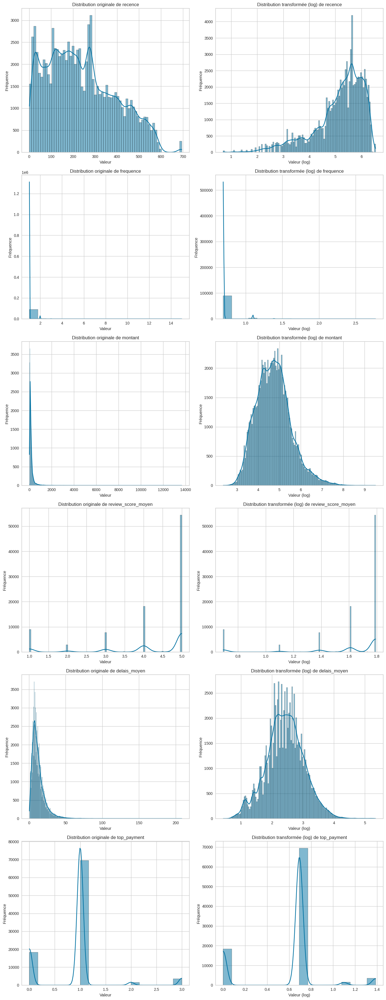

In [51]:
# analyse de la distribution
fig, axes = plt.subplots(6, 2, figsize=(14, 36))

for i, variable in enumerate(data.columns):
    # distribution originale
    sns.histplot(data[variable], kde=True, ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution originale de {variable}')
    axes[i, 0].set_xlabel('Valeur')
    axes[i, 0].set_ylabel('Fréquence')

    # distribution log
    data[f'log_{variable}'] = np.log1p(data[variable])  # utilisation de log1p pour éviter log(0)
    sns.histplot(data[f'log_{variable}'], kde=True, ax=axes[i, 1])
    axes[i, 1].set_title(f'Distribution transformée (log) de {variable}')
    axes[i, 1].set_xlabel('Valeur (log)')
    axes[i, 1].set_ylabel('Fréquence')

plt.tight_layout()
plt.show()

* le passage en log des variables permet d'obtenir des distributions qui s'apparentent à des distributions normales plus symétriques et permet de lisser l'effet des outliers sur certaines variables.
* nous allons garder la transformation log aux données pour nos futurs entrainements.




### Dataset log

In [52]:
data.head()

,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
customer_unique_id,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,5.0,6.411227,1,4.718499,0.693147,4.962145,1.791759,2.002996,0.693147
0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,4.0,3.285590,1,4.744932,0.693147,3.338967,1.609438,1.455258,0.693147
0000f46a3911fa3c0805444483337064,537,1,86.22,3.0,25.731759,1,6.287859,0.693147,4.468434,1.386294,3.285852,0.693147
0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,4.0,20.037083,1,5.774552,0.693147,3.798182,1.609438,3.046287,0.693147
0004aac84e0df4da2b147fca70cf8255,288,1,196.89,5.0,13.141134,1,5.666427,0.693147,5.287711,1.791759,2.649088,0.693147


### SAVE FINAL DATASET transformées et encodées

try:
    data.to_csv('./FINAL_data_rfm_transform.csv', index=False)
    print("Le DataFrame a été enregistré avec succès.")
except Exception as e:
    print(f"Une erreur est survenue lors de l'enregistrement : {e}")

In [56]:
data = pd.read_csv('./FINAL_data_rfm_transform.csv')
data.info()
display(data.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   recence                 92754 non-null  int64  
 1   frequence               92754 non-null  int64  
 2   montant                 92754 non-null  float64
 3   review_score_moyen      92754 non-null  float64
 4   delais_moyen            92754 non-null  float64
 5   top_payment             92754 non-null  int64  
 6   log_recence             92754 non-null  float64
 7   log_frequence           92754 non-null  float64
 8   log_montant             92754 non-null  float64
 9   log_review_score_moyen  92754 non-null  float64
 10  log_delais_moyen        92754 non-null  float64
 11  log_top_payment         92754 non-null  float64
dtypes: float64(9), int64(3)
memory usage: 8.5 MB


,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
0,111,1,141.90,5.0,6.411227,1,4.718499,0.693147,4.962145,1.791759,2.002996,0.693147
1,114,1,27.19,4.0,3.285590,1,4.744932,0.693147,3.338967,1.609438,1.455258,0.693147
2,537,1,86.22,3.0,25.731759,1,6.287859,0.693147,4.468434,1.386294,3.285852,0.693147
3,321,1,43.62,4.0,20.037083,1,5.774552,0.693147,3.798182,1.609438,3.046287,0.693147
4,288,1,196.89,5.0,13.141134,1,5.666427,0.693147,5.287711,1.791759,2.649088,0.693147


In [55]:
# sélection des variables RFM en log
data_rfm_log = data.filter(['log_recence', 'log_frequence', 'log_montant'])
data_rfm_log.head()

,log_recence,log_frequence,log_montant
0,4.718499,0.693147,4.962145
1,4.744932,0.693147,3.338967
2,6.287859,0.693147,4.468434
3,5.774552,0.693147,3.798182
4,5.666427,0.693147,5.287711


In [57]:
# Normalisation des données
scaler = StandardScaler()
data_rfm_log_scaled = scaler.fit_transform(data_rfm_log)

## CLUSTERING K-MEANS sur les 3 variables RFM

* KMeans est un algorithme de clustering utilisé pour partitionner un ensemble de données en un nombre fixe de clusters. Il est basé sur la minimisation de la variance intra-cluster, c'est-à-dire la somme des distances au carré entre les points de données et le centre de leur cluster respectif.

* Principes de KMeans :
    - Initialisation : Choisir k centres de clusters initiaux (appelés centroids). Cela peut être fait de manière aléatoire ou en utilisant des méthodes comme k-means++ pour une meilleure initialisation.
    - Assignation : Assigner chaque point de données au centroid le plus proche.(distance euclidienne)
    - Mise à Jour : Recalculer les centroids en prenant la moyenne des points assignés à chaque cluster.
    - Répétition : Répéter les étapes d'assignation et de mise à jour jusqu'à ce que les centroids ne changent plus significativement ou qu'un nombre maximal d'itérations soit atteint.
* Paramètres :
    - n_clusters : Le nombre de clusters à former.
    - init : La méthode d'initialisation des centroids ('k-means++', 'random', ou un tableau de centroids initiaux).
    - n_init : Le nombre de fois que l'algorithme sera exécuté avec des centroids initiaux différents.
    - max_iter : Le nombre maximal d'itérations pour une seule exécution de l'algorithme.
    - random_state : Le générateur de nombres aléatoires pour l'initialisation des centroids.
* Avantages :
    - Simplicité : Facile à comprendre et à implémenter.
    - Efficacité : Rapide pour des ensembles de données de taille modérée.
* Inconvénients :
    - Nombre de Clusters Fixe : Nécessite de spécifier le nombre de clusters à l'avance.
    - Sensibilité aux Outliers : Les outliers peuvent affecter les centroids.
    - Forme des Clusters : Suppose que les clusters sont de forme sphérique et de taille similaire.

### Nombre de cluster optimal

- Le score de silhouette aide à choisir le nombre optimal de clusters en identifiant la meilleure structure de clustering (compacité et séparation des clusters). Un bon clustering a généralement un score de silhouette élevé. 
- Le score de silhouette calcule la moyenne des coefficients de silhouette pour tous les points de données dans un ensemble de données. Il fournit une mesure globale de la qualité du clustering

Pour n_clusters = 3, le score de silhouette est 0.422
Pour n_clusters = 4, le score de silhouette est 0.396
Pour n_clusters = 5, le score de silhouette est 0.358
Pour n_clusters = 6, le score de silhouette est 0.354
Pour n_clusters = 7, le score de silhouette est 0.355
Pour n_clusters = 8, le score de silhouette est 0.347
Pour n_clusters = 9, le score de silhouette est 0.348
Pour n_clusters = 10, le score de silhouette est 0.342
Pour n_clusters = 11, le score de silhouette est 0.339
Pour n_clusters = 12, le score de silhouette est 0.333
Le nombre optimal de clusters est 3 avec un score de silhouette de 0.422


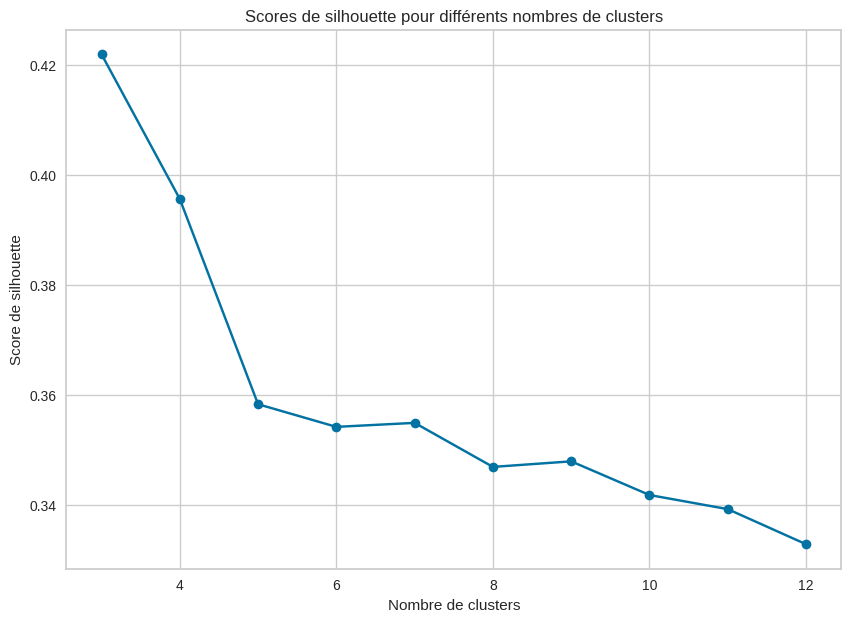

In [58]:

# Plage de nombres de clusters à tester
n_clusters_range = [3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

# Liste pour stocker les scores de silhouette
silhouette_scores = []

# Calculer le score de silhouette pour chaque nombre de clusters
for n_clusters in n_clusters_range:
    kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init=10, max_iter=300, random_state=42)
    cluster_labels = kmeans.fit_predict(data_rfm_log_scaled)
    silhouette_avg = silhouette_score(data_rfm_log_scaled, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    print(f"Pour n_clusters = {n_clusters}, le score de silhouette est {silhouette_avg:.3f}")

# Trouver le nombre de clusters avec le score de silhouette le plus élevé
optimal_n_clusters = n_clusters_range[np.argmax(silhouette_scores)]
print(f"Le nombre optimal de clusters est {optimal_n_clusters} avec un score de silhouette de {max(silhouette_scores):.3f}")

# Visualisation des scores de silhouette
plt.figure(figsize=(10, 7))
plt.plot(n_clusters_range, silhouette_scores, marker='o')
plt.title('Scores de silhouette pour différents nombres de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score de silhouette')
plt.show()

### Coefficients de silhouette suivants le nombre de cluster
- Le coefficient de silhouette est une mesure qui évalue la qualité de la séparation des clusters pour chaque point de données individuel. Il est calculé pour chaque point de données et se situe entre -1 et 1
- il permet de regarder dans le détail la compacité de chaque cluster dans une segmentation donnée. le coefficient de silhouette de chaque cluster doit tendre vers 1 pour indiquer une bonne séparation de chaque cluster et donc par extension une bonne qualité de segmentation.



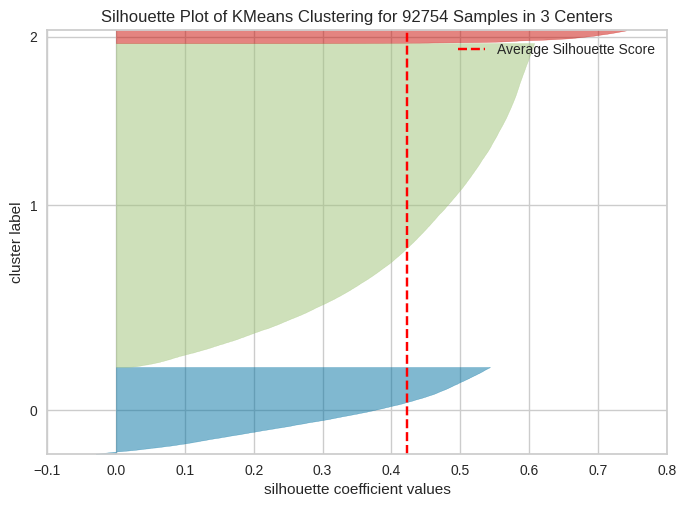

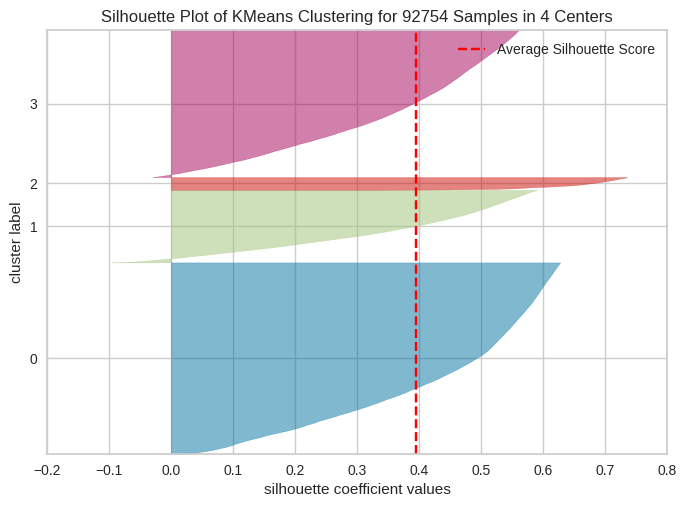

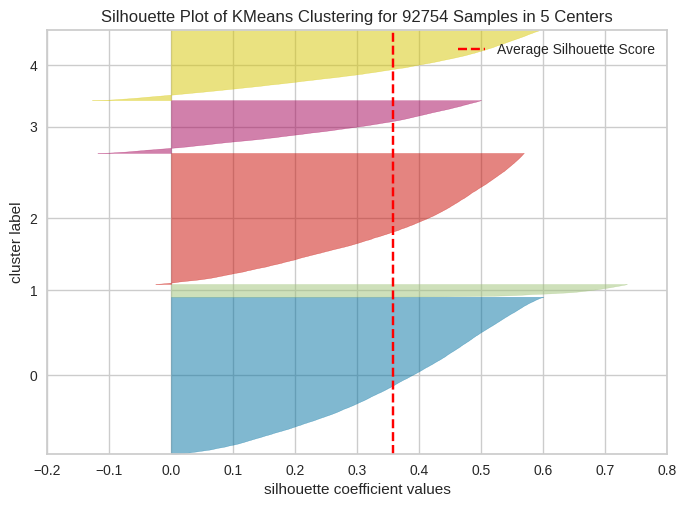

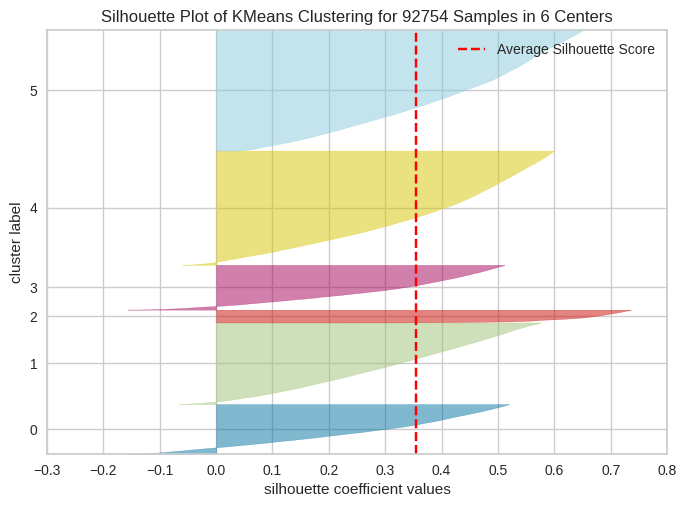

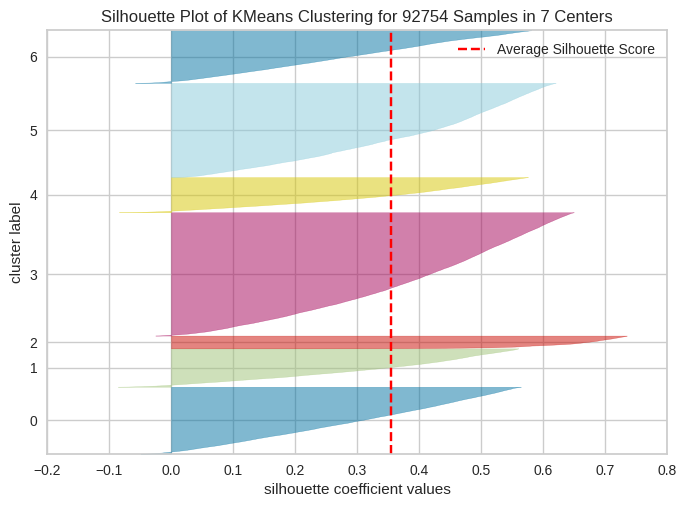

{3: 0.42189055634230727,
 4: 0.3955749308145503,
 5: 0.35825098801643396,
 6: 0.3541321683764576,
 7: 0.35486277710865}

In [59]:
scores_dict = {}

k_range = (3, 8)
# graphiques des coefficients de silhouette des clusters pour chaque nombre de clusters
for i in range(k_range[0], k_range[1]):
    kmeans = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=300, random_state=42)
    (fig, ax) = plt.subplots()
    visu = silhouette_visualizer(clone(kmeans), data_rfm_log_scaled, colors='yellowbrick', ax=ax)
    # index = nbre de clusters et valeur = score de silhouette 
    scores_dict[i] = visu.silhouette_score_  

scores_dict

### Méthode du coude
- tracer la distorsion / inertie en fonction du nombre de clusters (k) pour identifier le "coude" dans la courbe, ce qui indique un bon compromis entre le nombre de clusters et la qualité du clustering. (=faible distorision = les points qui composent les cluster sont proches de leurs centroides respectifs et indique des cluster compacts)

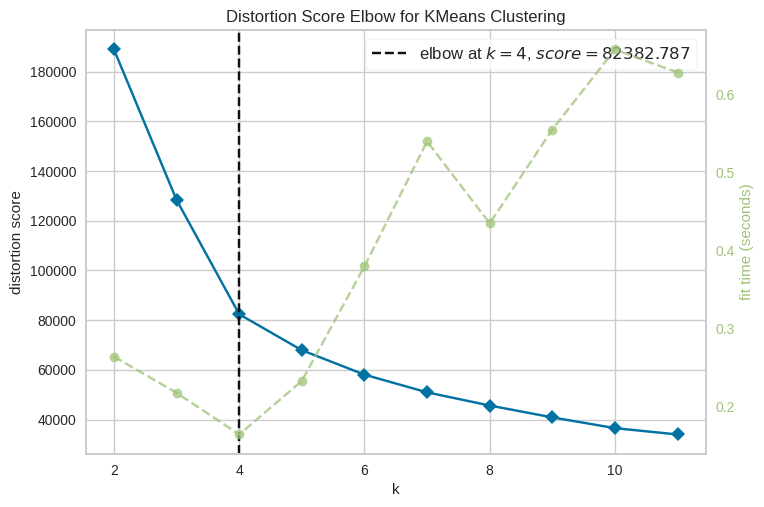

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [60]:
k_range = (2, 12)
kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init=10, max_iter=300, random_state=42)
visualizer_WCSS = KElbowVisualizer(kmeans, k=k_range, metric='distortion', locate_elbow=True)
visualizer_WCSS.fit(data_rfm_log_scaled)
visualizer_WCSS.show()

* pour notre kmeans, en regardant la distorsion (méthode du coude) et la silhouette (score moyen du cluster et coefficient de silhouette), nous obtenons des résultats qui nous indiquent soit 3 soit 4 clusters en optimal. nous allons obter pour une partition à 4 clusters.

### Réprésentation graphique des clusters 

In [61]:
# init le kmeans avec les 4 clusters
kmeans_rfm = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_rfm_log_kmeans = data_rfm_log.copy(deep=True)
data_rfm_log_kmeans['cluster'] = kmeans_rfm.fit_predict(data_rfm_log_scaled)
data_rfm_log_kmeans.head()

,log_recence,log_frequence,log_montant,cluster
0,4.718499,0.693147,4.962145,3
1,4.744932,0.693147,3.338967,0
2,6.287859,0.693147,4.468434,0
3,5.774552,0.693147,3.798182,0
4,5.666427,0.693147,5.287711,3


In [62]:
color_sequence = px.colors.qualitative.Set1

fig = go.Figure()

# légende des clusters dans l'ordre des labels
for cluster in sorted(data_rfm_log_kmeans['cluster'].unique()):
    fig.add_trace(go.Scatter3d(
        x=[None], y=[None], z=[None],
        mode='markers',
        marker=dict(size=10, color=color_sequence[cluster % len(color_sequence)]),
        showlegend=True,
        name=f'Cluster {cluster}'
    ))

# graphique 3d
for cluster in sorted(data_rfm_log_kmeans['cluster'].unique()):
    cluster_data = data_rfm_log_kmeans[data_rfm_log_kmeans['cluster'] == cluster]
    fig.add_trace(go.Scatter3d(
        x=cluster_data['log_recence'],
        y=cluster_data['log_frequence'],
        z=cluster_data['log_montant'],
        mode='markers',
        marker=dict(size=5, color=color_sequence[cluster % len(color_sequence)]),
        showlegend=False,
        name=f'Cluster {cluster}'
    ))

# titres graphique et axes
fig.update_layout(
    title='KMeans sur RFM - 4 Clusters',
    scene=dict(
        xaxis_title='Récence',
        yaxis_title='Fréquence',
        zaxis_title='Montant'
    ),
    legend_title_text='Clusters'
)

fig.show()

### CONCLUSION KMEANS sur les 3 variables RFM
* les segments de clientèle sont bien mieux définis et homogènes que pour la segmentation RFM basée sur les quantiles.

## CLUSTERING DBSCAN sur les 3 variables RFM

* DBSCAN (Density-Based Spatial Clustering of Applications with Noise) est un algorithme de clustering basé sur la densité. Contrairement au KMeans, qui nécessite de spécifier le nombre de clusters à l'avance, le DBSCAN identifie automatiquement les clusters en fonction de la densité des points de données. 

* Principes de DBSCAN :
    - Points Cœur (Core Points) : Points avec au moins min_samples points dans leur voisinage (défini par le rayon eps).
    - Points Frontière (Border Points) : Points qui ne sont pas des points cœur mais qui sont dans le voisinage d'un point cœur.
    - Points Bruit (Noise Points) : Points qui ne sont ni des points cœur ni des points frontière.
* Paramètres :
    - eps : Distance maximale entre deux points pour qu'ils soient considérés comme voisins.
    - min_samples : Nombre minimum de points requis pour former un point cœur.
* Avantages :
    - Peut détecter des clusters de forme non sphérique.
    - Identifie les points de bruit qui ne font partie d'aucun cluster.
    - Pas besoin de spécifier le nombre de clusters.
* Inconvénients :
    - Sensibilité aux Paramètres : Les résultats peuvent varier en fonction des valeurs de eps et min_samples.
    - Performance : Peut être moins performant sur des ensembles de données très grands ou de haute dimension.


* il faut veiller à utiliser des paramètres qui permettent de créer suffisamment de points intérieurs (ce qui n'arrivera pas si  min_samples est trop grand ou  eps  trop petit). En particulier, cela signifie que DBSCAN ne pourra pas trouver des clusters de densités différentes.

In [63]:
data_rfm_log.head()

,log_recence,log_frequence,log_montant
0,4.718499,0.693147,4.962145
1,4.744932,0.693147,3.338967
2,6.287859,0.693147,4.468434
3,5.774552,0.693147,3.798182
4,5.666427,0.693147,5.287711


### Valeurs optimales d'epsilon et min_samples
- eps (epsilon) : La distance maximale entre deux points pour qu'ils soient considérés comme voisins.
- min_samples : Le nombre minimum de points requis pour former un point cœur.

In [64]:
param_grid = {
    'eps': np.arange(0.1, 1.1, 0.1),
    'min_samples': range(3, 8)}

results = []
# init les clustering en fonction des combinaisons des paramètres
for params in ParameterGrid(param_grid):
    dbscan = DBSCAN(eps=params['eps'], min_samples=params['min_samples'])
    cluster_labels = dbscan.fit_predict(data_rfm_log_scaled)
    
    # score de silhouette uniquement si plus d'un cluster est formé
    if len(set(cluster_labels)) > 1:
        silhouette_avg = silhouette_score(data_rfm_log_scaled, cluster_labels)
        results.append((params, silhouette_avg))
        print(f"Pour eps = {params['eps']}, min_samples = {params['min_samples']}, le score de silhouette est {silhouette_avg:.3f}")

best_params, best_score = max(results, key=lambda x: x[1])
print(f"Meilleurs paramètres : {best_params}, avec un score de silhouette de {best_score:.3f}")

Pour eps = 0.1, min_samples = 3, le score de silhouette est -0.139
Pour eps = 0.1, min_samples = 4, le score de silhouette est -0.138
Pour eps = 0.1, min_samples = 5, le score de silhouette est -0.101
Pour eps = 0.1, min_samples = 6, le score de silhouette est -0.155
Pour eps = 0.1, min_samples = 7, le score de silhouette est -0.183
Pour eps = 0.2, min_samples = 3, le score de silhouette est 0.466
Pour eps = 0.2, min_samples = 4, le score de silhouette est 0.474
Pour eps = 0.2, min_samples = 5, le score de silhouette est 0.477
Pour eps = 0.2, min_samples = 6, le score de silhouette est 0.469
Pour eps = 0.2, min_samples = 7, le score de silhouette est 0.529
Pour eps = 0.30000000000000004, min_samples = 3, le score de silhouette est 0.574
Pour eps = 0.30000000000000004, min_samples = 4, le score de silhouette est 0.584
Pour eps = 0.30000000000000004, min_samples = 5, le score de silhouette est 0.560
Pour eps = 0.30000000000000004, min_samples = 6, le score de silhouette est 0.559
Pour ep

### Coefficient de score de Silouhette

eps = 0.4, min_samples = 3 - Score de silhouette moyen : 0.609
eps = 0.4, min_samples = 4 - Score de silhouette moyen : 0.619
eps = 0.4, min_samples = 5 - Score de silhouette moyen : 0.617
eps = 0.5, min_samples = 3 - Score de silhouette moyen : 0.695
eps = 0.5, min_samples = 4 - Score de silhouette moyen : 0.694
eps = 0.5, min_samples = 5 - Score de silhouette moyen : 0.694
eps = 0.6, min_samples = 3 - Score de silhouette moyen : 0.695
eps = 0.6, min_samples = 4 - Score de silhouette moyen : 0.695
eps = 0.6, min_samples = 5 - Score de silhouette moyen : 0.695
eps = 0.8, min_samples = 3 - Score de silhouette moyen : 0.695
eps = 0.8, min_samples = 4 - Score de silhouette moyen : 0.695
eps = 0.8, min_samples = 5 - Score de silhouette moyen : 0.695
eps = 1.0, min_samples = 3 - Score de silhouette moyen : 0.695
eps = 1.0, min_samples = 4 - Score de silhouette moyen : 0.695
eps = 1.0, min_samples = 5 - Score de silhouette moyen : 0.695
eps = 0.4, min_samples = 3 - Score de silhouette moyen 

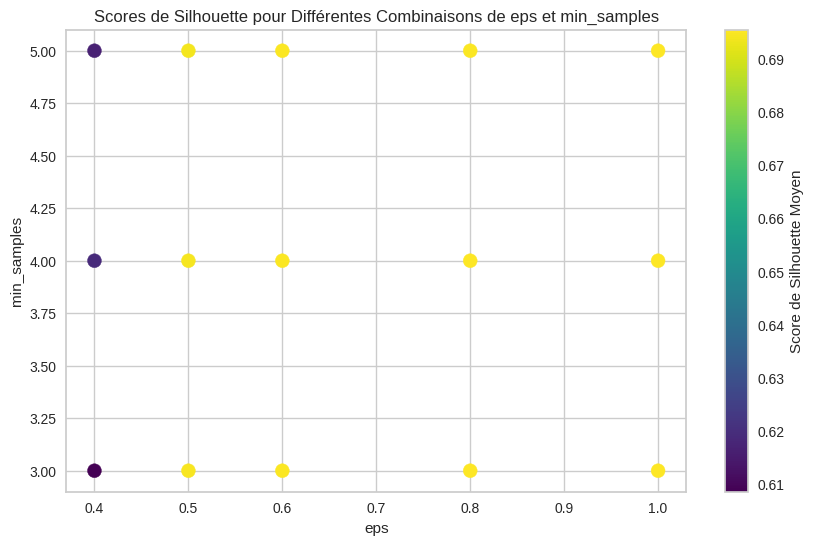

In [66]:
# Dictionnaire pour stocker les scores de silhouette
scores_dict = {}

# Plage de valeurs pour eps et min_samples à tester
eps_liste = [0.4, 0.5, 0.6, 0.8, 1.0]
min_samples_liste = [3, 4, 5]

# pour chaque combinaison de paramètres récupérer les labels des clusters formés
for eps in eps_liste:
    for min_samples in min_samples_liste:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(data_rfm_log_scaled)
        
        # récupérer les scores de silhouette uniquement si plus d'un cluster est formé
        if len(set(cluster_labels)) > 1:
            silhouette_avg = silhouette_score(data_rfm_log_scaled, cluster_labels)
            scores_dict[(eps, min_samples)] = silhouette_avg
            print(f"eps = {eps}, min_samples = {min_samples} - Score de silhouette moyen : {silhouette_avg:.3f}")

# scores de silhouette si plus d'un cluster est formé
for params, score in scores_dict.items():
    print(f"eps = {params[0]}, min_samples = {params[1]} - Score de silhouette moyen : {score:.3f}")

# graphique des scores de silhouette pour chaque combianaison si plus d'un cluster est formé
params = list(scores_dict.keys())
scores = list(scores_dict.values())

eps_values = [param[0] for param in params]
min_samples_values = [param[1] for param in params]

fig, ax = plt.subplots(figsize=(10, 6))
scatter = ax.scatter(eps_values, min_samples_values, c=scores, cmap='viridis', s=100)
ax.set_xlabel('eps')
ax.set_ylabel('min_samples')
ax.set_title('Scores de Silhouette pour Différentes Combinaisons de eps et min_samples')
cbar = plt.colorbar(scatter)
cbar.set_label('Score de Silhouette Moyen')
plt.show()

### Réprésentation des clusters 

In [67]:
# init le meilleur dbscan
dbscan_rfm = DBSCAN(eps=0.5, min_samples=3)
# rajouter les clusters pour chaque individus du dataset
data_rfm_log_dbscan = data_rfm_log.copy(deep=True)
data_rfm_log_dbscan['cluster'] = dbscan_rfm.fit_predict(data_rfm_log_scaled)
data_rfm_log_dbscan.head()

,log_recence,log_frequence,log_montant,cluster
0,4.718499,0.693147,4.962145,0
1,4.744932,0.693147,3.338967,0
2,6.287859,0.693147,4.468434,0
3,5.774552,0.693147,3.798182,0
4,5.666427,0.693147,5.287711,0


In [68]:
data_rfm_log_dbscan.cluster.unique()

array([ 0,  1,  2,  3, -1,  4,  5,  6])

In [69]:
color_sequence = px.colors.qualitative.Set1
fig = go.Figure()

# légende des clusters dans l'ordre des labels
for cluster in sorted(data_rfm_log_dbscan['cluster'].unique()):
    fig.add_trace(go.Scatter3d(
        x=[None], y=[None], z=[None],
        mode='markers',
        marker=dict(size=10, color=color_sequence[cluster % len(color_sequence)]),
        showlegend=True,
        name=f'Cluster {cluster}'
    ))

# graphique 3d
for cluster in sorted(data_rfm_log_dbscan['cluster'].unique()):
    cluster_data = data_rfm_log_dbscan[data_rfm_log_dbscan['cluster'] == cluster]
    fig.add_trace(go.Scatter3d(
        x=cluster_data['log_recence'],
        y=cluster_data['log_frequence'],
        z=cluster_data['log_montant'],
        mode='markers',
        marker=dict(size=5, color=color_sequence[cluster % len(color_sequence)]),
        showlegend=False,
        name=f'Cluster {cluster}'
    ))

# titres graphique et axes
fig.update_layout(
    title=f"DBSCAN sur RFM - {data_rfm_log_dbscan.cluster.nunique()} clusters",
    scene=dict(
        xaxis_title='Récence',
        yaxis_title='Fréquence',
        zaxis_title='Montant'
    ),
    legend_title_text='Clusters'
)

fig.show()

### CONCLUSION DBSCAN sur les 3 variables RFM
* il semble que les segments de clientèle sont  définis surtout par la fréquence d'achat, ce qui ne parait pas comme une partition très fiable
* la difficulté du DBSCAN ici est sûrement aux variables discrétisées, ce qui affecte son analyse sur la densité des données.
* nous ne retiendrons donc pas cette segmentation.

## CLUSTERING CHA sur les 3 variables RFM

* CHA (Classification Hiérarchique Ascendante), ou  clustering agglomératif , est une méthode qui cherche à construire une hiérarchie de clusters.
    - La 1ère étape consiste à considérer chaque individu du dataset comme un cluster individuel. 
    - Puis va s'enchaîner des  phases dites de fusion : les 2 clusters les plus proches vont ainis être fusionnés/agglomérés en un seul nouveau cluster. 
    - à cette étape, vont être utliser une mesure de distance entre les individus et une mesure de distance entre les clusters.
    - Le processus se répète jusqu'à l'obtention d'un unique cluster englobant tous les indivius du dataset initial. La représentation graphique se fait par un dendogramme. On détermine le nombre de cluster (et leur composition) en "coupant" l'arbre de clusters au niveau choisi.

* Mesure de distance entre les individus : La notion de ressemblance entre observations est évaluée par une distance entre individus. Il existe plusieurs distances mathématiques pour les variables quantitatives :
    - Euclidean : Distance euclidienne.
    - Manhattan : Distance de Manhattan. => Manhattan : Données continues ou discrètes avec échelles différentes.
    - Cosine : Distance cosinus.  

* Mesure de distance des clusters :
    - Méthode des Liens (linkage method) : détermine comment la distance entre les clusters est calculée. Les méthodes courantes incluent :

        - Le lien simple (simple linkage) : on considère que la distance entre 2 clusters est la distance entre leurs 2 points les plus proches. Cela est équivalent à dire "deux clusters sont proches si au moins deux de leurs points sont proches".

        - Le lien complet (complete linkage) : on considère que la distance entre 2 clusters est la distance entre leurs 2 points les plus éloignés. Cela équivaut donc à dire "deux clusters sont proches si tous leurs points sont proches".

        - Le lien moyen : on considère que la distance entre 2 clusters est la moyenne de toutes les distances entre les points d'un cluster et les points de l'autre cluster. Pour la calculer, on énumère toutes les paires de points possibles d'un cluster à l'autre, puis on calcule la distance de chaque paire, puis on calcule la moyenne.

        - Le lien centroïdal : on considère que la distance entre 2 clusters est la distance entre les centroïdes de ceux-ci.
        - Les méthodes de lien permettent de garantir que les clusters sont bien séparés, car on prend en compte la distance entre les clusters. Cependant, elles ne garantissent pas que les clusters soient resserrés sur eux-mêmes (c'est la notion d'inertie intraclasse).
    - Méthode de Ward :  à chaque itération, c'est-à-dire à chaque fois que 2 clusters sont regroupés en 1, cherche à minimiser l'augmentation d'inertie intraclasse due au regroupement des 2 clusters. Par défaut, on préfère en général utiliser la méthode de Ward.




* Avantages :
    - Pas besoin de Spécifier le Nombre de Clusters : Le nombre de clusters peut être déterminé en coupant le dendrogramme à un certain niveau.
    - Visualisation : Le dendrogramme offre une visualisation claire de la hiérarchie des clusters, permettant d'explorer la structure des données.
    - Flexibilité : Peut être utilisé avec différentes mesures de distance et méthodes de linkage.
* Inconvénients :
    - Complexité : Peut être computationalement coûteux pour de grands ensembles de données, car la complexité est généralement O(n^3).
    - Sensibilité aux Outliers : Les outliers peuvent affecter la structure des clusters et fausser les résultats.
    - Rigidité : Une fois qu'une fusion est faite, elle ne peut pas être annulée, ce qui peut conduire à des clusters sous-optimaux.



### Recherche de mesures optimales de distance entre individus et entre clusters, sur un échantillon du dataset 

In [70]:
# sélection d'un échantillon du dataset
sample_rfm_log = data_rfm_log.sample(n=2000, random_state=42)

# normalisation
scaler = StandardScaler()
sample_rfm_log_scaled = scaler.fit_transform(sample_rfm_log)

In [71]:
scores_dict = {}

# mesures de distance entre cluster et individus à tester
dist_cluster_methods = ['single', 'complete', 'average', 'ward', 'centroid']
dist_indiv_metrics = ['euclidean', 'cityblock', 'cosine']

# Calculer le score de silhouette pour chaque combinaison de mesures de distance entre cluster et individus
for method in dist_cluster_methods:
    for metric in dist_indiv_metrics:
        # la méthode de Ward et centroid ne supportent que la distance euclidienne
        if (method == 'ward' or method == 'centroid') and metric != 'euclidean':
            continue
        
        Z = linkage(sample_rfm_log_scaled, method=method, metric=metric)
        
        # Déterminer les clusters en coupant le dendrogramme
        max_d = 7.5  # Vous pouvez ajuster cette valeur en fonction de votre dendrogramme
        clusters = fcluster(Z, max_d, criterion='distance')
        
        # Calculer le score de silhouette uniquement si plus d'un cluster est formé
        if len(set(clusters)) > 1:
            silhouette_avg = silhouette_score(sample_rfm_log_scaled, clusters, metric=metric)
            scores_dict[(method, metric)] = silhouette_avg
            print(f"Méthode de linkage = {method}, Mesure de distance = {metric} - Score de silhouette moyen : {silhouette_avg:.3f}")

# Affichage des scores de silhouette
for params, score in scores_dict.items():
    print(f"Méthode de linkage = {params[0]}, Mesure de distance = {params[1]} - Score de silhouette moyen : {score:.3f}")

scores_dict

Méthode de linkage = complete, Mesure de distance = euclidean - Score de silhouette moyen : 0.490
Méthode de linkage = complete, Mesure de distance = cityblock - Score de silhouette moyen : 0.306
Méthode de linkage = average, Mesure de distance = cityblock - Score de silhouette moyen : 0.720
Méthode de linkage = ward, Mesure de distance = euclidean - Score de silhouette moyen : 0.302
Méthode de linkage = complete, Mesure de distance = euclidean - Score de silhouette moyen : 0.490
Méthode de linkage = complete, Mesure de distance = cityblock - Score de silhouette moyen : 0.306
Méthode de linkage = average, Mesure de distance = cityblock - Score de silhouette moyen : 0.720
Méthode de linkage = ward, Mesure de distance = euclidean - Score de silhouette moyen : 0.302


{('complete', 'euclidean'): 0.48973179219147334,
 ('complete', 'cityblock'): 0.30641305082484604,
 ('average', 'cityblock'): 0.720269688199116,
 ('ward', 'euclidean'): 0.30189069019718867}

### Coefficient de score de Silouhette

Méthode de linkage = ('complete', 'euclidean') - Score de silhouette moyen : 0.490
Méthode de linkage = ('complete', 'cityblock') - Score de silhouette moyen : 0.306
Méthode de linkage = ('average', 'cityblock') - Score de silhouette moyen : 0.720
Méthode de linkage = ('ward', 'euclidean') - Score de silhouette moyen : 0.302
Types des méthodes: [<class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>]
Types des scores: [<class 'numpy.float64'>, <class 'numpy.float64'>, <class 'numpy.float64'>, <class 'numpy.float64'>]


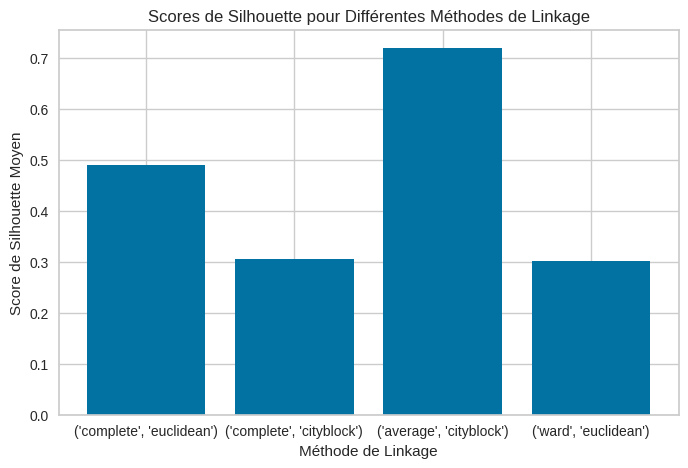

In [72]:
# Affichage des scores de silhouette
for method, score in scores_dict.items():
    print(f"Méthode de linkage = {method} - Score de silhouette moyen : {score:.3f}")

# Représentation graphique des scores de silhouette
methods = [str(method) for method in scores_dict.keys()]
scores = list(scores_dict.values())

# Afficher les types des éléments pour déboguer
print("Types des méthodes:", [type(m) for m in methods])
print("Types des scores:", [type(s) for s in scores])

plt.figure(figsize=(8, 5))
plt.bar(methods, scores)
plt.xlabel('Méthode de Linkage')
plt.ylabel('Score de Silhouette Moyen')
plt.title('Scores de Silhouette pour Différentes Méthodes de Linkage')
plt.show()

* la combinaison du lien moyen et de la mesure Manhattan semble être la mieux adaptée à l'échantillon de données

### Dendogramme sur l'échantillon de données

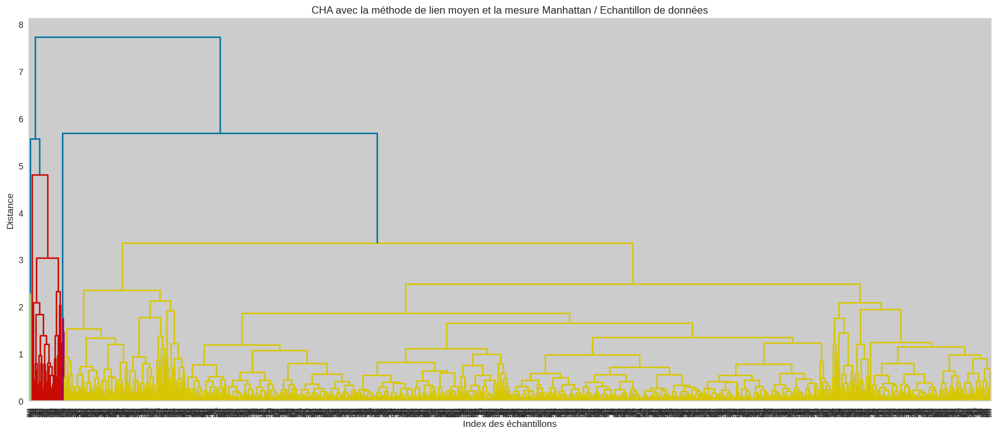

In [73]:
CHA_rfm = linkage(sample_rfm_log_scaled, method='average', metric='cityblock')

plt.figure(figsize=(20, 8))
plt.title("CHA avec la méthode de lien moyen et la mesure Manhattan / Echantillon de données" )
dendrogram(CHA_rfm)
plt.xlabel('Index des échantillons')
plt.ylabel('Distance')
plt.show()

Groupes uniques de clusters :
[1 2 3 4]


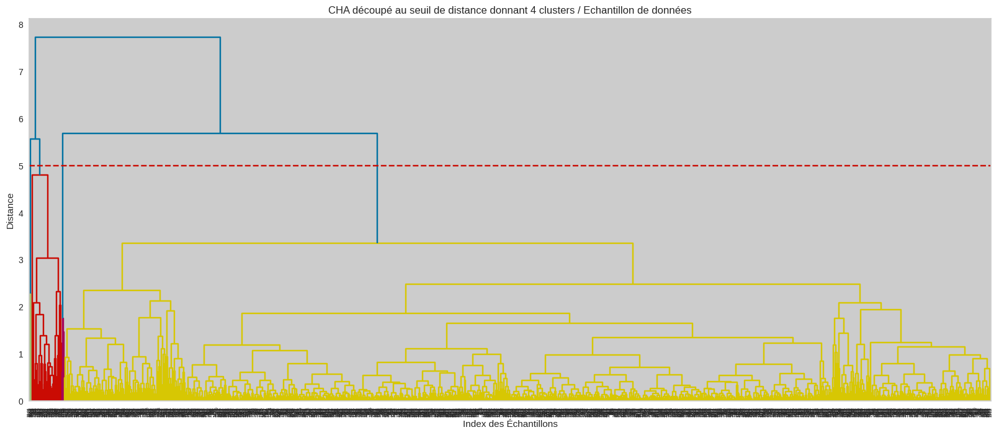

In [75]:
CHA_rfm = linkage(sample_rfm_log_scaled, method='average', metric='cityblock')

# Définir la distance de coupure
cutoff_distance = 5

# récupérer les clusters en fonction du seuil de distance
clusters = fcluster(CHA_rfm, cutoff_distance, criterion='distance')
unique_clusters = np.unique(clusters)
print("Groupes uniques de clusters :")
print(unique_clusters)

plt.figure(figsize=(20, 8))
dendrogram(CHA_rfm, color_threshold=cutoff_distance)
plt.axhline(y=cutoff_distance, color='r', linestyle='--')
plt.title('CHA découpé au seuil de distance donnant 4 clusters / Echantillon de données')
plt.xlabel('Index des Échantillons')
plt.ylabel('Distance')
plt.show()

### Dendogramme sur l'ensemble des données

In [76]:
CHA_rfm = linkage(data_rfm_log_scaled, method='average', metric='cityblock')

cutoff_distance = 5.5
# récupérer les clusters en fonction du seuil de distance
clusters = fcluster(CHA_rfm, cutoff_distance, criterion='distance')
unique_clusters = np.unique(clusters)
print("Groupes uniques de clusters :")
print(unique_clusters)

plt.figure(figsize=(20, 8))
dendrogram(CHA_rfm, color_threshold=cutoff_distance)
plt.axhline(y=cutoff_distance, color='r', linestyle='--')
plt.title('CHA découpé au seuil de distance donnant 4 clusters / Ensemble des données')
plt.xlabel('Index des Échantillons')
plt.ylabel('Distance')
plt.show()

MemoryError: Unable to allocate 32.0 GiB for an array with shape (4301605881,) and data type float64

### CONCLUSION CHA sur les 3 variables RFM

* sur un petit éhcantillonage des données, la CHA semble indiquer comme le kmeans qu'une segmentation basée sur 4 clusters, ce qui parait cohérent avec les données.
* Cependant, il est impossible de lancer la CHA sur l'ensemble des données "MemoryError: Unable to allocate 32.0 GiB for an array with shape (4301605881,) and data type float64"
* en terme de coût de computation, la CHA n'est pas utilisable pour cette segmentation en raison du grand nombre d'individus dans ce dataset.
* nous ne retiendrons donc pas cette segmentation.

# OPTIMISATION K-MEANS
* rajouter une à une les variables retenues aux variables RFM déjà utilisées pour identifier les meilleurs algorithmes de clustering

In [78]:
data_transfo = pd.read_csv('./FINAL_data_rfm_transform.csv')
data_transfo.info()
display(data_transfo.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   recence                 92754 non-null  int64  
 1   frequence               92754 non-null  int64  
 2   montant                 92754 non-null  float64
 3   review_score_moyen      92754 non-null  float64
 4   delais_moyen            92754 non-null  float64
 5   top_payment             92754 non-null  int64  
 6   log_recence             92754 non-null  float64
 7   log_frequence           92754 non-null  float64
 8   log_montant             92754 non-null  float64
 9   log_review_score_moyen  92754 non-null  float64
 10  log_delais_moyen        92754 non-null  float64
 11  log_top_payment         92754 non-null  float64
dtypes: float64(9), int64(3)
memory usage: 8.5 MB


,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
0,111,1,141.90,5.0,6.411227,1,4.718499,0.693147,4.962145,1.791759,2.002996,0.693147
1,114,1,27.19,4.0,3.285590,1,4.744932,0.693147,3.338967,1.609438,1.455258,0.693147
2,537,1,86.22,3.0,25.731759,1,6.287859,0.693147,4.468434,1.386294,3.285852,0.693147
3,321,1,43.62,4.0,20.037083,1,5.774552,0.693147,3.798182,1.609438,3.046287,0.693147
4,288,1,196.89,5.0,13.141134,1,5.666427,0.693147,5.287711,1.791759,2.649088,0.693147


## RFM + review_score_moyen

In [80]:
data_rfm_rev = data_transfo.filter(['log_recence', 'log_frequence', 'log_montant', 'log_review_score_moyen'])
data_rfm_rev.head()

,log_recence,log_frequence,log_montant,log_review_score_moyen
0,4.718499,0.693147,4.962145,1.791759
1,4.744932,0.693147,3.338967,1.609438
2,6.287859,0.693147,4.468434,1.386294
3,5.774552,0.693147,3.798182,1.609438
4,5.666427,0.693147,5.287711,1.791759


In [81]:
# Normalisation des données
scaler = StandardScaler()
data_rfm_rev_scaled = scaler.fit_transform(data_rfm_rev)

# K-MEANS sur RFM + review_score_moyen

## Nombre de cluster optimal

- Le score de silhouette aide à choisir le nombre optimal de clusters en identifiant la meilleure structure de clustering (compacité et séparation des clusters). Un bon clustering a généralement un score de silhouette élevé. 
- Le score de silhouette calcule la moyenne des coefficients de silhouette pour tous les points de données dans un ensemble de données. Il fournit une mesure globale de la qualité du clustering

Pour n_clusters = 2, le score de silhouette est 0.650
Pour n_clusters = 3, le score de silhouette est 0.456
Pour n_clusters = 4, le score de silhouette est 0.394
Pour n_clusters = 5, le score de silhouette est 0.358
Pour n_clusters = 6, le score de silhouette est 0.320
Pour n_clusters = 7, le score de silhouette est 0.312
Pour n_clusters = 8, le score de silhouette est 0.300
Pour n_clusters = 9, le score de silhouette est 0.296
Pour n_clusters = 10, le score de silhouette est 0.297
Pour n_clusters = 11, le score de silhouette est 0.288
Pour n_clusters = 12, le score de silhouette est 0.293
Le nombre optimal de clusters est 2 avec un score de silhouette de 0.650


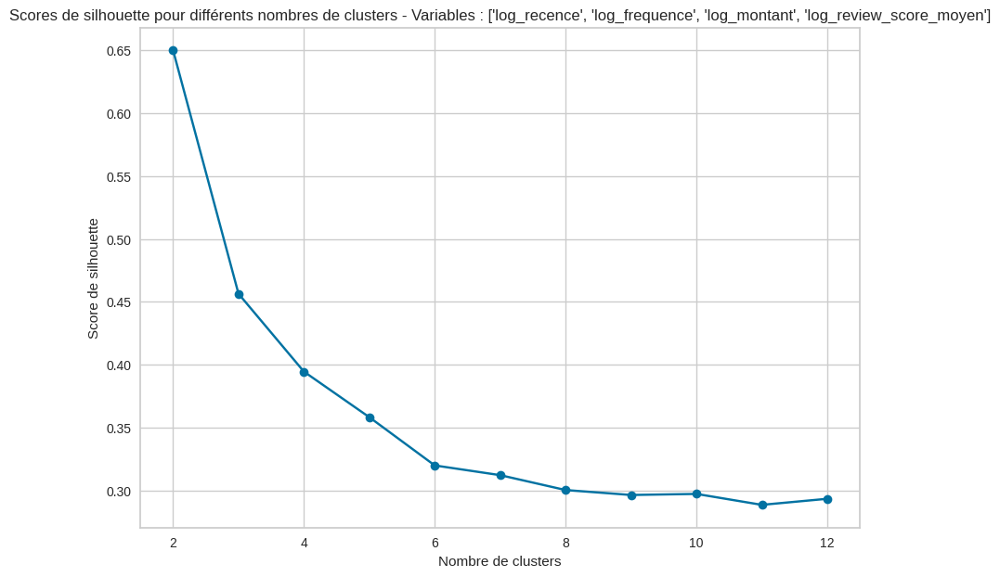

In [82]:
plot_silhouette_scores(data_rfm_rev, data_rfm_rev_scaled, n_clusters_range = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])

### Coefficients de silhouette suivants le nombre de cluster
- Le coefficient de silhouette est une mesure qui évalue la qualité de la séparation des clusters pour chaque point de données individuel. Il est calculé pour chaque point de données et se situe entre -1 et 1
- il permet de regarder dans le détail la compacité de chaque cluster dans une segmentation donnée. le coefficient de silhouette de chaque cluster doit tendre vers 1 pour indiquer une bonne séparation de chaque cluster et donc par extension une bonne qualité de segmentation.



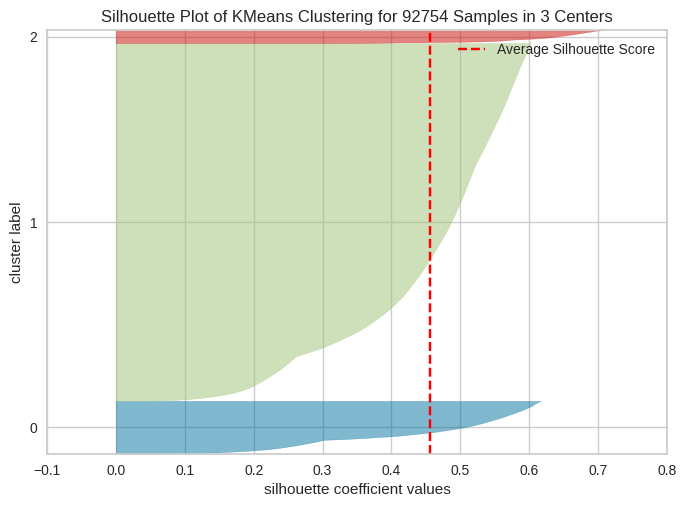

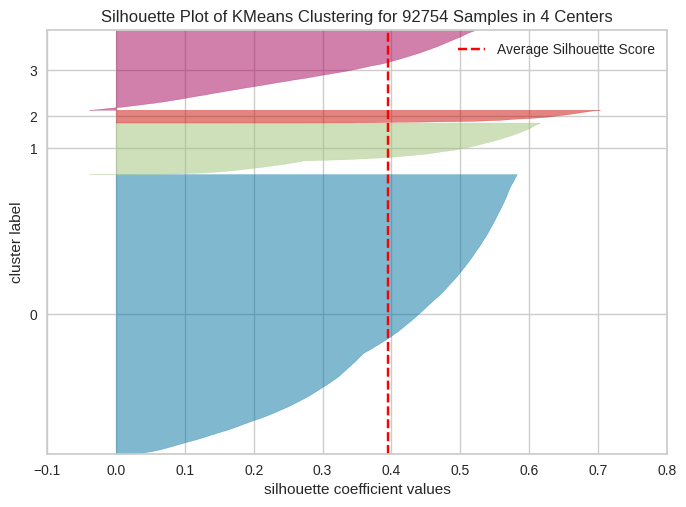

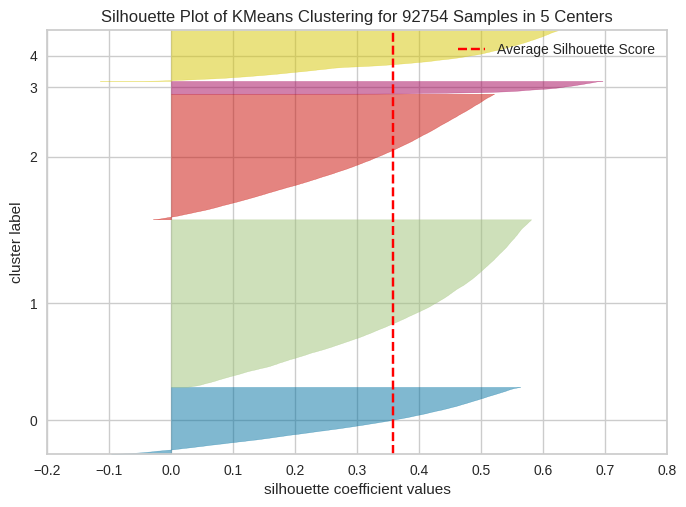

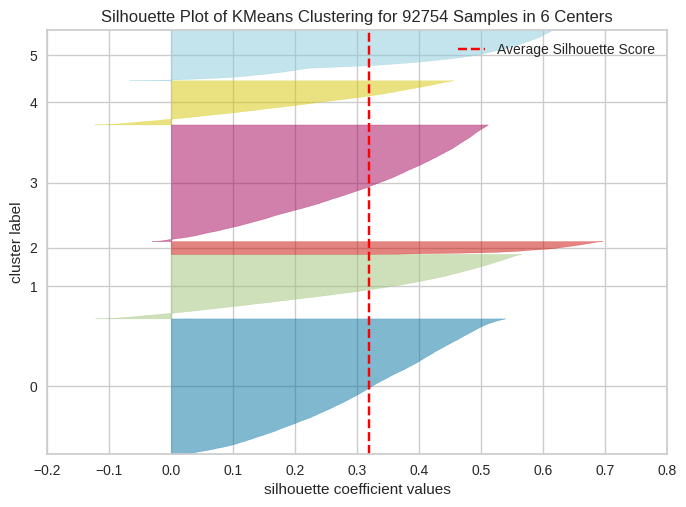

{3: 0.45638216200674964,
 4: 0.3944079246258585,
 5: 0.35813823989608445,
 6: 0.3197623035788853}

In [83]:
plot_silhouette_coef(data_rfm_rev, data_rfm_rev_scaled, k_range=(3, 7))

### Méthode du coude
- tracer la distorsion / inertie en fonction du nombre de clusters (k) pour identifier le "coude" dans la courbe, ce qui indique un bon compromis entre le nombre de clusters et la qualité du clustering. (=faible distorision = les points qui composent les cluster sont proches de leurs centroides respectifs et indique des cluster compacts)

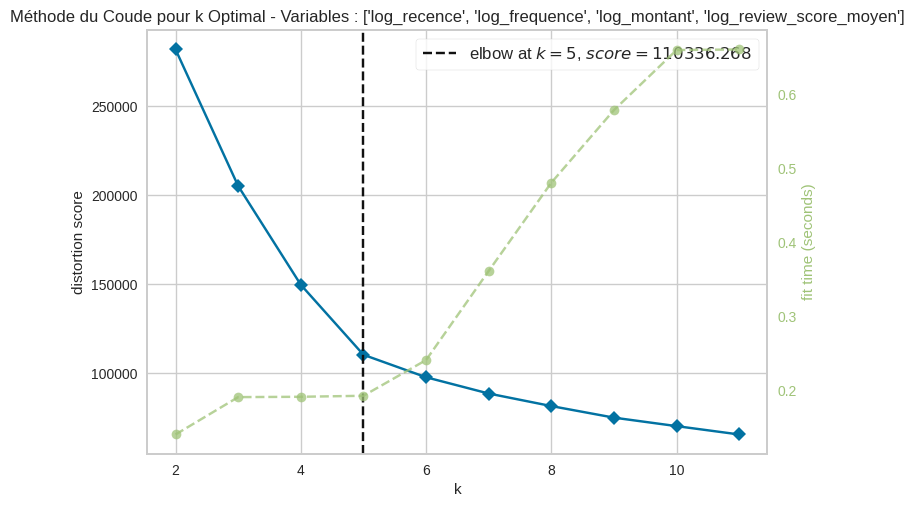

In [84]:
plot_elbow_method(data_rfm_rev, data_rfm_rev_scaled, k_range=(2, 12))

## Réprésentation graphique des clusters 

In [85]:
# init le kmeans avec les 4 clusters
kmeans_rfm_rev = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_rfm_rev_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen'])
data_rfm_rev_kmeans['cluster'] = kmeans_rfm_rev.fit_predict(data_rfm_rev_scaled)
data_rfm_rev_kmeans.head()

,recence,frequence,montant,review_score_moyen,cluster
0,111,1,141.90,5.0,0
1,114,1,27.19,4.0,0
2,537,1,86.22,3.0,0
3,321,1,43.62,4.0,0
4,288,1,196.89,5.0,0


In [86]:
data_rfm_rev_kmeans.cluster.unique()

array([0, 1, 3, 2], dtype=int32)

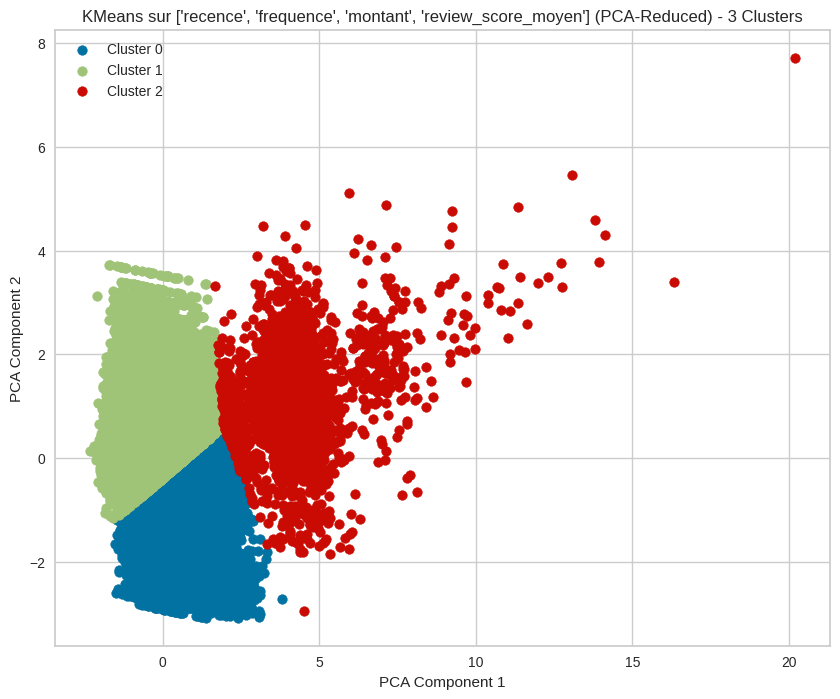

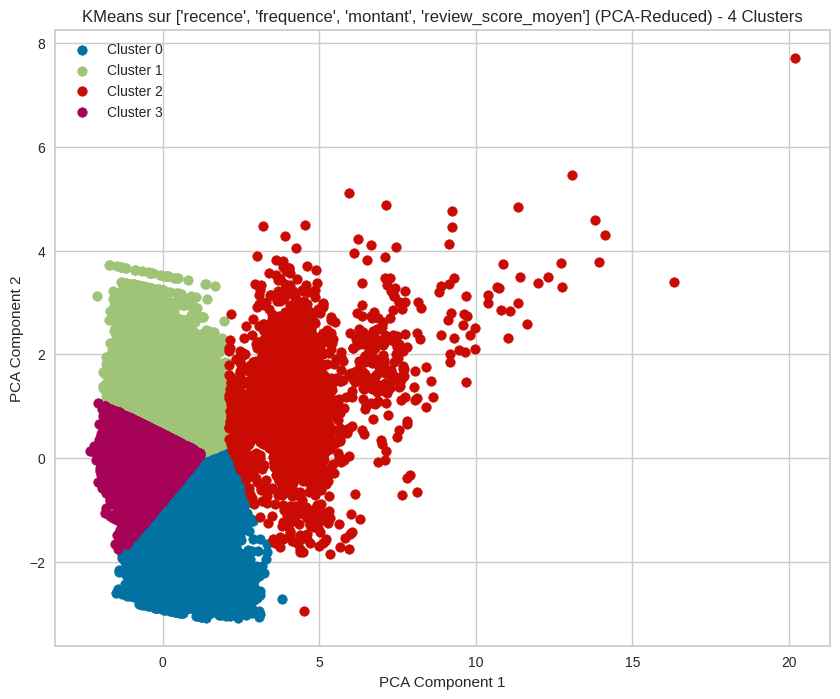

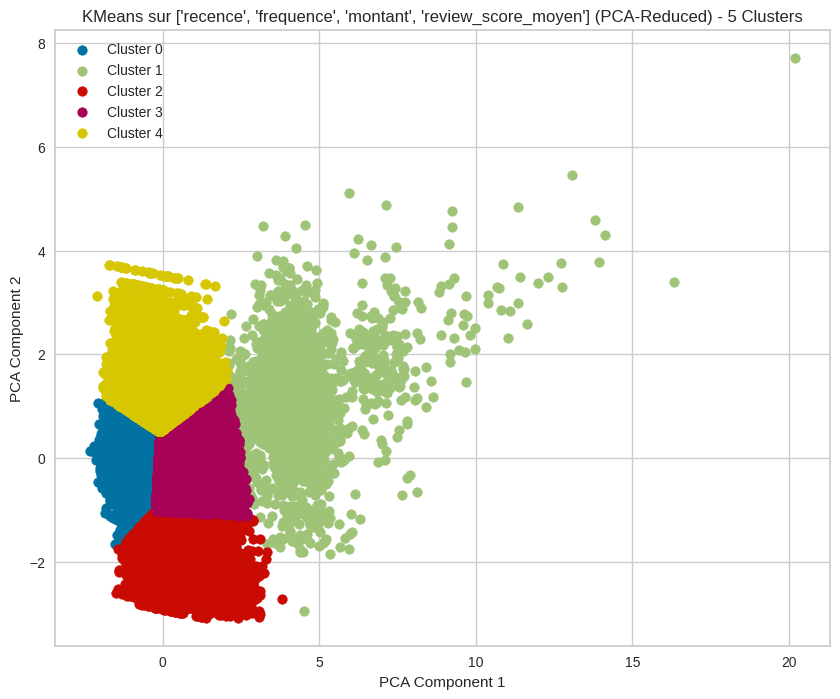

In [87]:
data_rfm_rev_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen'])
plot_kmeans_PCA_clusters(data_rfm_rev_kmeans, data_rfm_rev_scaled, [3, 4, 5])

## CONCLUSION KMEANS sur les 3 variables RFM + review_score
* les métriques d'évaluation donnent chacune un résultat différent quant au nombre de cluster optimaux (3, 4 ou 5).
* les représentations graphiques montrent que les 3 nbres de clusters montrent des clustering assez cohérents.
* pour cette configuration de variables, nous allons garder la segmentation à 4 clusters.
* voyons en rajoutant d'autres variables le comportement du kmeans

# K-MEANS sur RFM + review_score_moyen + delais_moyen

In [88]:
data_transfo = pd.read_csv('./FINAL_data_rfm_transform.csv')
data_transfo.info()
display(data_transfo.tail())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   recence                 92754 non-null  int64  
 1   frequence               92754 non-null  int64  
 2   montant                 92754 non-null  float64
 3   review_score_moyen      92754 non-null  float64
 4   delais_moyen            92754 non-null  float64
 5   top_payment             92754 non-null  int64  
 6   log_recence             92754 non-null  float64
 7   log_frequence           92754 non-null  float64
 8   log_montant             92754 non-null  float64
 9   log_review_score_moyen  92754 non-null  float64
 10  log_delais_moyen        92754 non-null  float64
 11  log_top_payment         92754 non-null  float64
dtypes: float64(9), int64(3)
memory usage: 8.5 MB


,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
92749,447,1,2067.42,5.0,27.514861,1,6.104793,0.693147,7.634540,1.791759,3.350425,0.693147
92750,262,1,84.58,4.0,30.097500,1,5.572154,0.693147,4.449452,1.609438,3.437127,0.693147
92751,568,1,112.46,5.0,14.872083,1,6.343880,0.693147,4.731450,1.791759,2.764562,0.693147
92752,119,1,133.69,5.0,11.858854,1,4.787492,0.693147,4.902976,1.791759,2.554033,0.693147
92753,484,1,71.56,5.0,7.552118,1,6.184149,0.693147,4.284414,1.791759,2.146179,0.693147


## RFM + review_score_moyen + delais_moyen

In [89]:
data_rfm_rev_del = data_transfo.filter(['log_recence', 'log_frequence', 'log_montant', 'log_review_score_moyen', 'log_delais_moyen'])
data_rfm_rev_del.head()

,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen
0,4.718499,0.693147,4.962145,1.791759,2.002996
1,4.744932,0.693147,3.338967,1.609438,1.455258
2,6.287859,0.693147,4.468434,1.386294,3.285852
3,5.774552,0.693147,3.798182,1.609438,3.046287
4,5.666427,0.693147,5.287711,1.791759,2.649088


In [90]:
# Normalisation des données
scaler = StandardScaler()
data_rfm_rev_del_scaled = scaler.fit_transform(data_rfm_rev_del)

## Nombre de cluster optimal

Pour n_clusters = 2, le score de silhouette est 0.593
Pour n_clusters = 3, le score de silhouette est 0.381
Pour n_clusters = 4, le score de silhouette est 0.301
Pour n_clusters = 5, le score de silhouette est 0.262
Pour n_clusters = 6, le score de silhouette est 0.250
Pour n_clusters = 7, le score de silhouette est 0.238
Pour n_clusters = 8, le score de silhouette est 0.236
Pour n_clusters = 9, le score de silhouette est 0.232
Pour n_clusters = 10, le score de silhouette est 0.227
Pour n_clusters = 11, le score de silhouette est 0.226
Pour n_clusters = 12, le score de silhouette est 0.218
Le nombre optimal de clusters est 2 avec un score de silhouette de 0.593


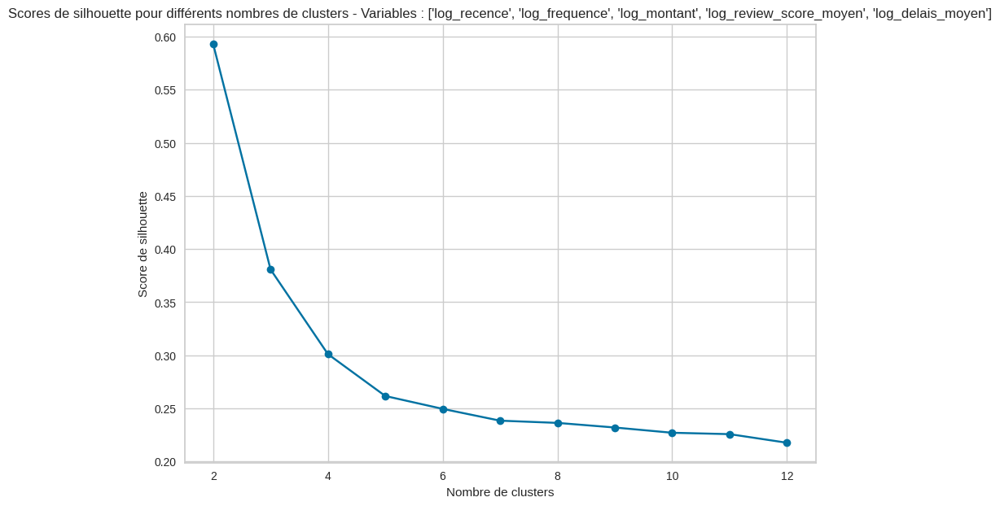

In [91]:
plot_silhouette_scores(data_rfm_rev_del, data_rfm_rev_del_scaled, n_clusters_range = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])

### Coefficients de silhouette suivants le nombre de cluster
- Le coefficient de silhouette est une mesure qui évalue la qualité de la séparation des clusters pour chaque point de données individuel. Il est calculé pour chaque point de données et se situe entre -1 et 1
- il permet de regarder dans le détail la compacité de chaque cluster dans une segmentation donnée. le coefficient de silhouette de chaque cluster doit tendre vers 1 pour indiquer une bonne séparation de chaque cluster et donc par extension une bonne qualité de segmentation.



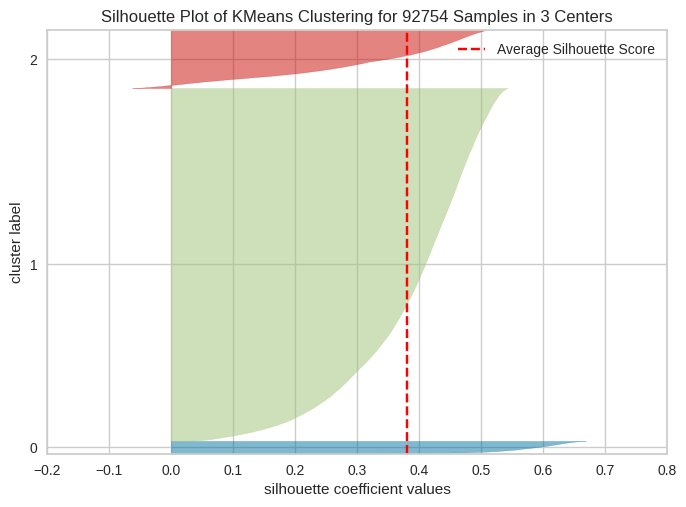

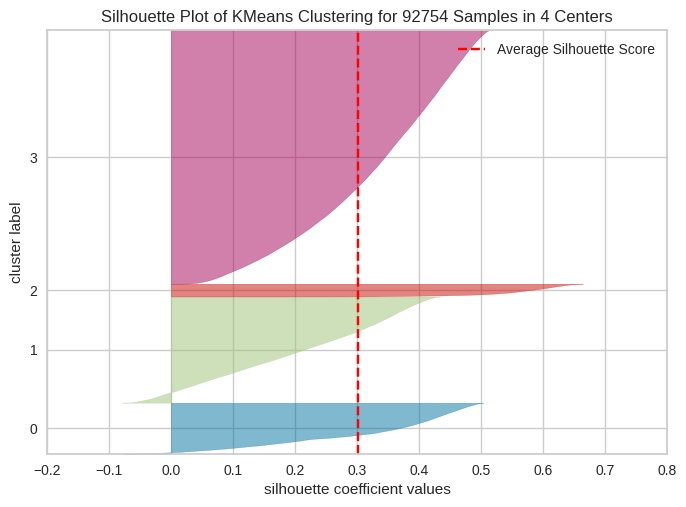

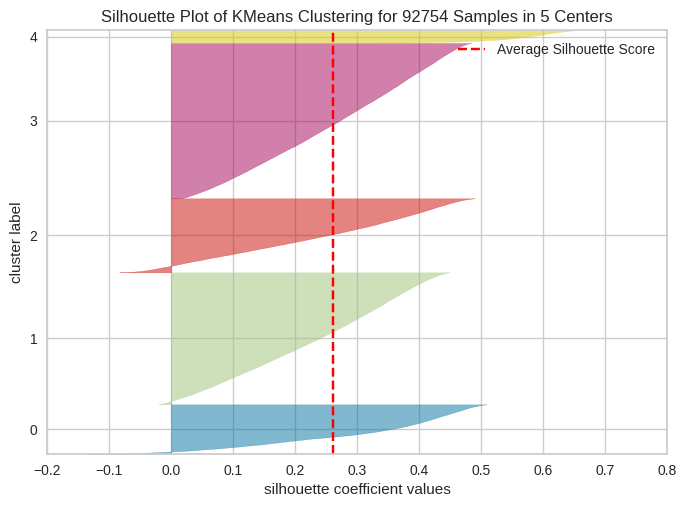

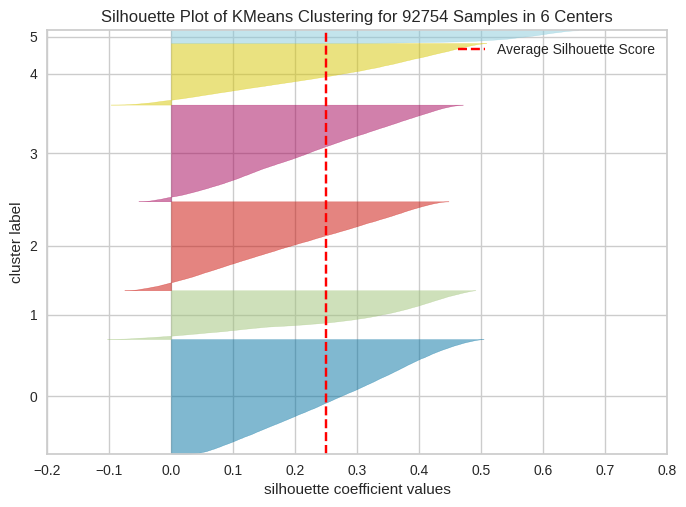

{3: 0.3807765114043664,
 4: 0.30109926107931884,
 5: 0.26166619649242356,
 6: 0.249564797790428}

In [92]:
plot_silhouette_coef(data_rfm_rev_del, data_rfm_rev_del_scaled, k_range=(3, 7))

### Méthode du coude
- tracer la distorsion / inertie en fonction du nombre de clusters (k) pour identifier le "coude" dans la courbe, ce qui indique un bon compromis entre le nombre de clusters et la qualité du clustering. (=faible distorision = les points qui composent les cluster sont proches de leurs centroides respectifs et indique des cluster compacts)

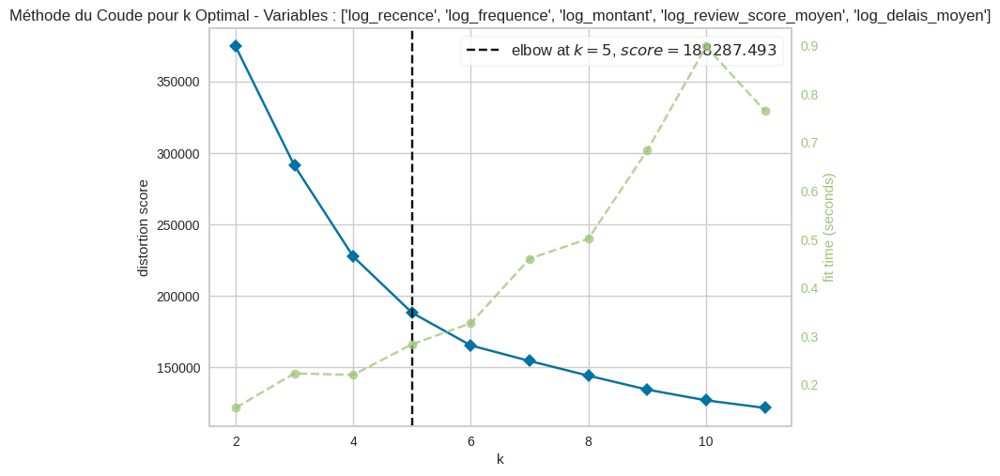

In [93]:
plot_elbow_method(data_rfm_rev_del, data_rfm_rev_del_scaled, k_range=(2, 12))

## Réprésentation graphique des clusters 

In [94]:
# init le kmeans avec les 4 clusters
kmeans_rfm_rev_del = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_rfm_rev_del_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen'])
data_rfm_rev_del_kmeans['cluster'] = kmeans_rfm_rev_del.fit_predict(data_rfm_rev_del_scaled)
data_rfm_rev_del_kmeans.head()

,recence,frequence,montant,review_score_moyen,delais_moyen,cluster
0,111,1,141.90,5.0,6.411227,1
1,114,1,27.19,4.0,3.285590,1
2,537,1,86.22,3.0,25.731759,3
3,321,1,43.62,4.0,20.037083,3
4,288,1,196.89,5.0,13.141134,3


In [95]:
data_rfm_rev_del_kmeans.cluster.unique()

array([1, 3, 0, 2], dtype=int32)

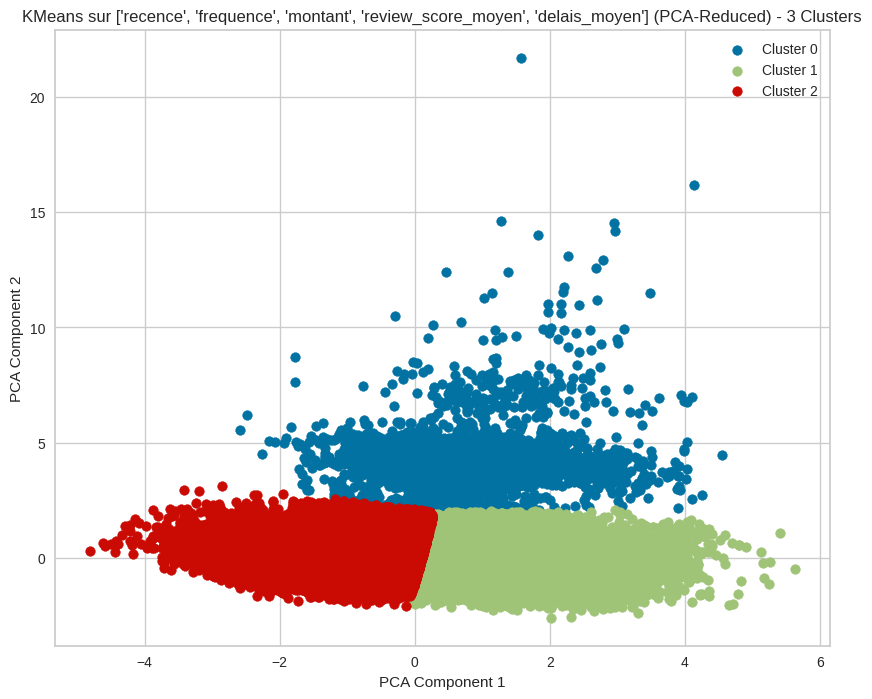

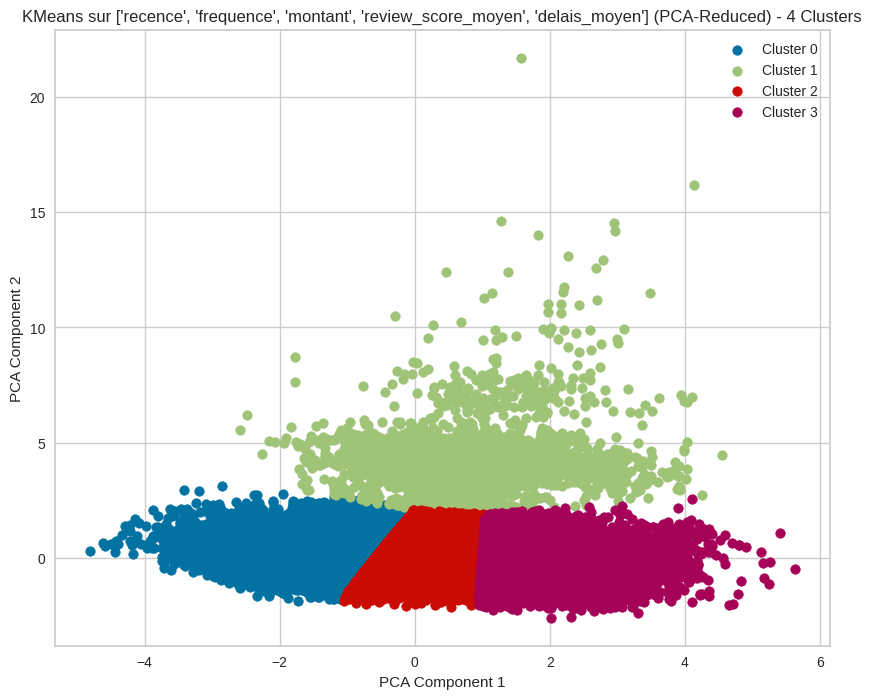

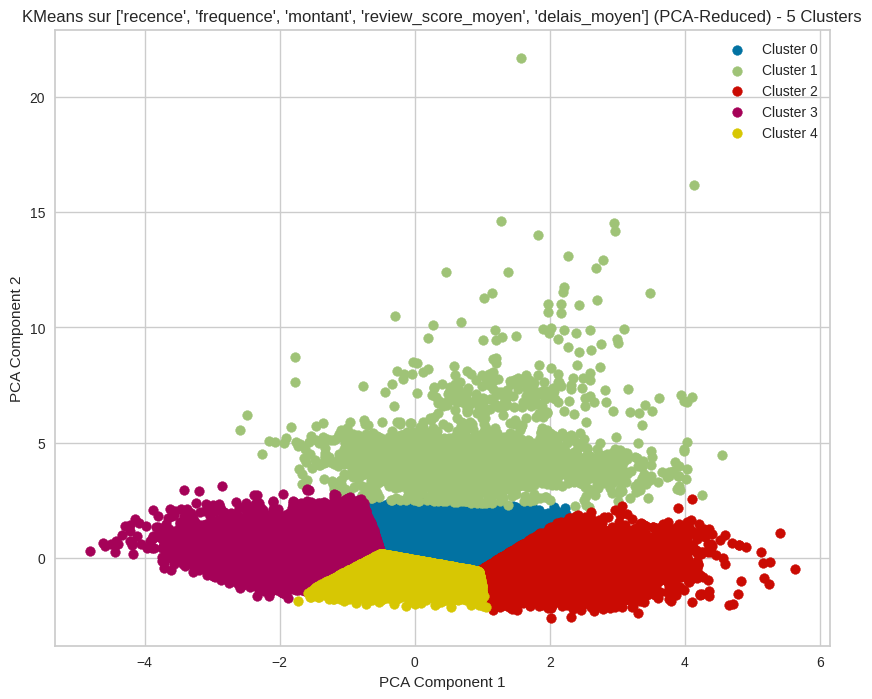

In [96]:
data_rfm_rev_del_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen'])

plot_kmeans_PCA_clusters(data_rfm_rev_del_kmeans, data_rfm_rev_del_scaled, [3, 4, 5])

## CONCLUSION KMEANS RFM + review_score_moyen + delai_moyen
* les score de silhouette et coefficient de silhouette tendent vers un nbre optimal de cluster de 3, la elbow method en indique 5
* les représentations graphiques montrent que les 2 nbres de clusters montrent des clustering assez cohérents.
* pour cette configuration de variables, nous allons garder une segmentation à 4 clusters.

# K-MEANS sur RFM + review_score_moyen + delais_moyen + top_payment

In [97]:
data_transfo = pd.read_csv('./FINAL_data_rfm_transform.csv')
data_transfo.info()
display(data_transfo.tail())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   recence                 92754 non-null  int64  
 1   frequence               92754 non-null  int64  
 2   montant                 92754 non-null  float64
 3   review_score_moyen      92754 non-null  float64
 4   delais_moyen            92754 non-null  float64
 5   top_payment             92754 non-null  int64  
 6   log_recence             92754 non-null  float64
 7   log_frequence           92754 non-null  float64
 8   log_montant             92754 non-null  float64
 9   log_review_score_moyen  92754 non-null  float64
 10  log_delais_moyen        92754 non-null  float64
 11  log_top_payment         92754 non-null  float64
dtypes: float64(9), int64(3)
memory usage: 8.5 MB


,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
92749,447,1,2067.42,5.0,27.514861,1,6.104793,0.693147,7.634540,1.791759,3.350425,0.693147
92750,262,1,84.58,4.0,30.097500,1,5.572154,0.693147,4.449452,1.609438,3.437127,0.693147
92751,568,1,112.46,5.0,14.872083,1,6.343880,0.693147,4.731450,1.791759,2.764562,0.693147
92752,119,1,133.69,5.0,11.858854,1,4.787492,0.693147,4.902976,1.791759,2.554033,0.693147
92753,484,1,71.56,5.0,7.552118,1,6.184149,0.693147,4.284414,1.791759,2.146179,0.693147


In [98]:
data_transfo.log_top_payment.unique()

array([0.69314718, 0.        , 1.38629436, 1.09861229])

In [99]:
data_transfo.log_top_payment.value_counts()

log_top_payment
0.693147    69443
0.000000    18367
1.386294     3484
1.098612     1460
Name: count, dtype: int64

In [100]:
data_transfo.top_payment.value_counts()

top_payment
1    69443
0    18367
3     3484
2     1460
Name: count, dtype: int64

## RFM + review_score_moyen + delais_moyen + top_payment

In [101]:
data_rfm_rev_del_pay = data_transfo.filter(['log_recence', 'log_frequence', 'log_montant', 'log_review_score_moyen', 'log_delais_moyen', 'log_top_payment'])
data_rfm_rev_del_pay.head()

,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
0,4.718499,0.693147,4.962145,1.791759,2.002996,0.693147
1,4.744932,0.693147,3.338967,1.609438,1.455258,0.693147
2,6.287859,0.693147,4.468434,1.386294,3.285852,0.693147
3,5.774552,0.693147,3.798182,1.609438,3.046287,0.693147
4,5.666427,0.693147,5.287711,1.791759,2.649088,0.693147


In [102]:
# Normalisation des données
scaler = StandardScaler()
data_rfm_rev_del_pay_scaled = scaler.fit_transform(data_rfm_rev_del_pay)

## Nombre de cluster optimal

Pour n_clusters = 2, le score de silhouette est 0.547
Pour n_clusters = 3, le score de silhouette est 0.326
Pour n_clusters = 4, le score de silhouette est 0.243
Pour n_clusters = 5, le score de silhouette est 0.285
Pour n_clusters = 6, le score de silhouette est 0.247
Pour n_clusters = 7, le score de silhouette est 0.235
Pour n_clusters = 8, le score de silhouette est 0.233
Pour n_clusters = 9, le score de silhouette est 0.223
Pour n_clusters = 10, le score de silhouette est 0.225
Pour n_clusters = 11, le score de silhouette est 0.221
Pour n_clusters = 12, le score de silhouette est 0.227
Le nombre optimal de clusters est 2 avec un score de silhouette de 0.547


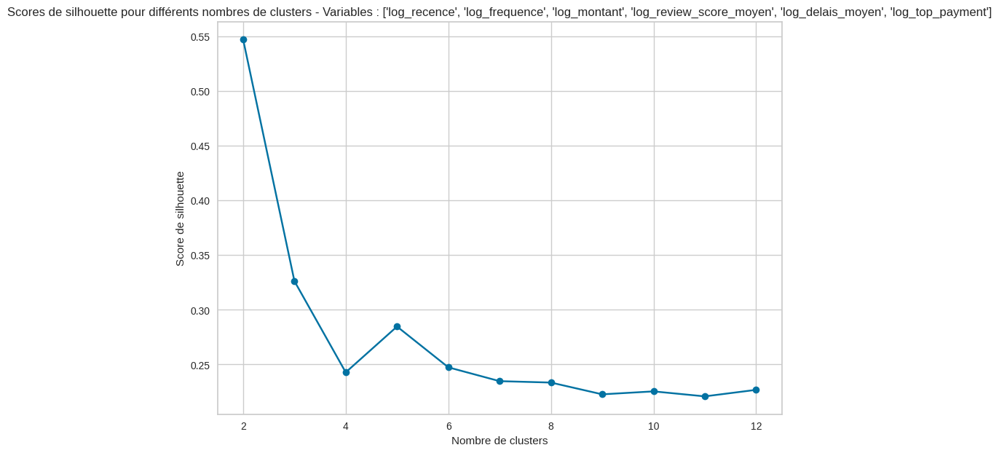

In [103]:
plot_silhouette_scores(data_rfm_rev_del_pay, data_rfm_rev_del_pay_scaled, n_clusters_range = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])

### Coefficients de silhouette suivants le nombre de cluster
- Le coefficient de silhouette est une mesure qui évalue la qualité de la séparation des clusters pour chaque point de données individuel. Il est calculé pour chaque point de données et se situe entre -1 et 1
- il permet de regarder dans le détail la compacité de chaque cluster dans une segmentation donnée. le coefficient de silhouette de chaque cluster doit tendre vers 1 pour indiquer une bonne séparation de chaque cluster et donc par extension une bonne qualité de segmentation.



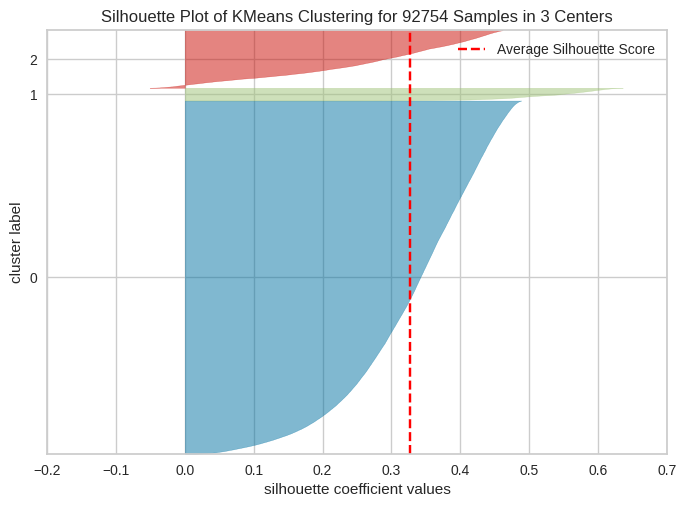

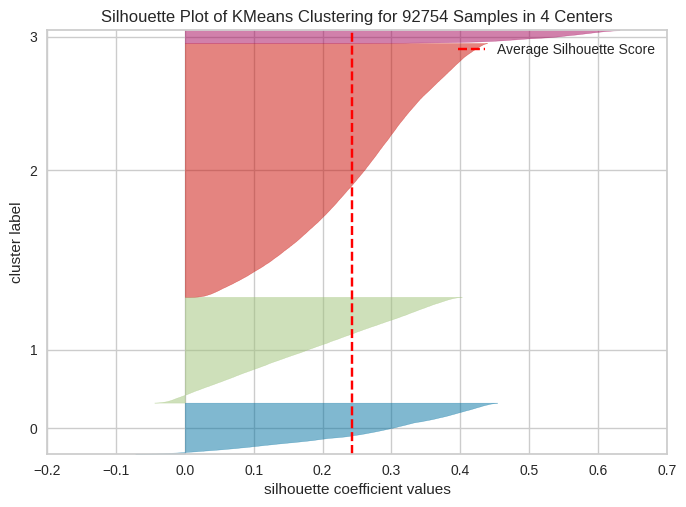

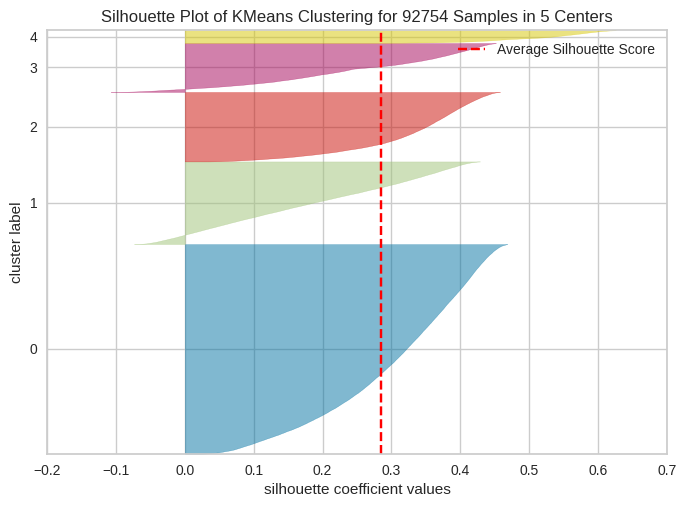

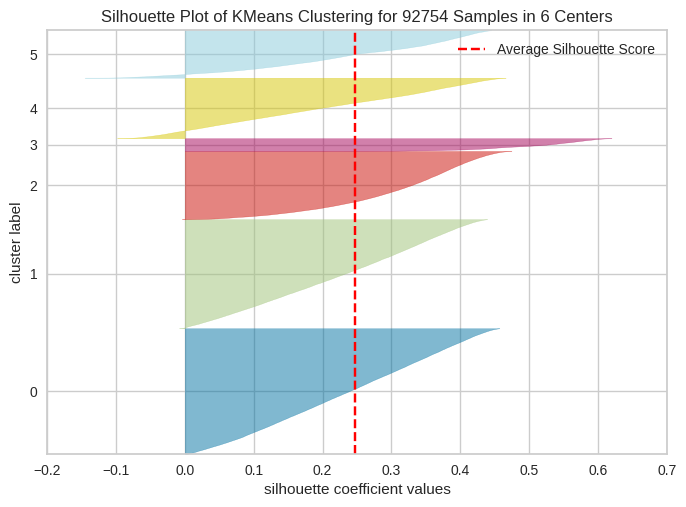

{3: 0.32623507945601693,
 4: 0.24281484055167513,
 5: 0.2847252660280802,
 6: 0.24740589187389844}

In [104]:
plot_silhouette_coef(data_rfm_rev_del_pay, data_rfm_rev_del_pay_scaled, k_range=(3, 7))

### Méthode du coude
- tracer la distorsion / inertie en fonction du nombre de clusters (k) pour identifier le "coude" dans la courbe, ce qui indique un bon compromis entre le nombre de clusters et la qualité du clustering. (=faible distorision = les points qui composent les cluster sont proches de leurs centroides respectifs et indique des cluster compacts)

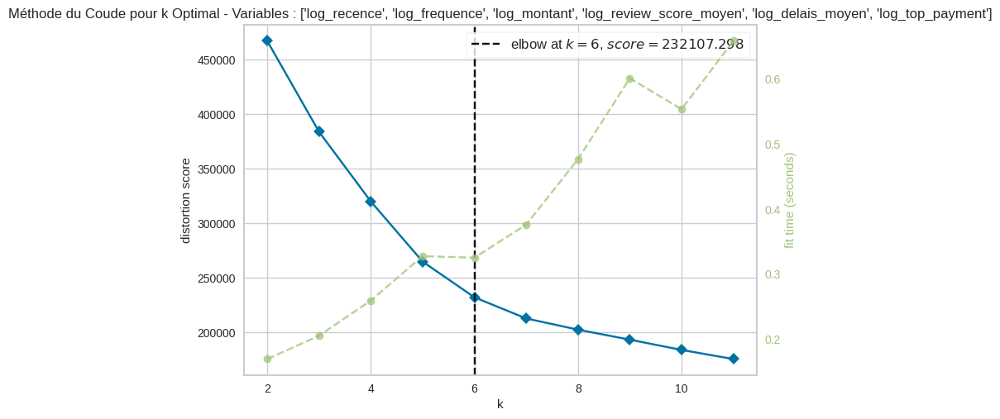

In [105]:
plot_elbow_method(data_rfm_rev_del_pay, data_rfm_rev_del_pay_scaled, k_range=(2, 12))

## Réprésentation graphique des clusters 

In [147]:
# init le kmeans avec les 4 clusters
kmeans_rfm_rev_del_pay = KMeans(n_clusters=5, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_rfm_rev_del_pay_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'])
data_rfm_rev_del_pay_kmeans['cluster'] = kmeans_rfm_rev_del_pay.fit_predict(data_rfm_rev_del_pay_scaled)
data_rfm_rev_del_pay_kmeans.head()

,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment,cluster
0,160,1,141.90,5.0,6.411227,1,1
1,163,1,27.19,4.0,3.285590,1,1
2,586,1,86.22,3.0,25.731759,1,0
3,370,1,43.62,4.0,20.037083,1,0
4,337,1,196.89,5.0,13.141134,1,0


In [148]:
data_rfm_rev_del_pay_kmeans.cluster.unique()

array([1, 0, 3, 2, 4], dtype=int32)

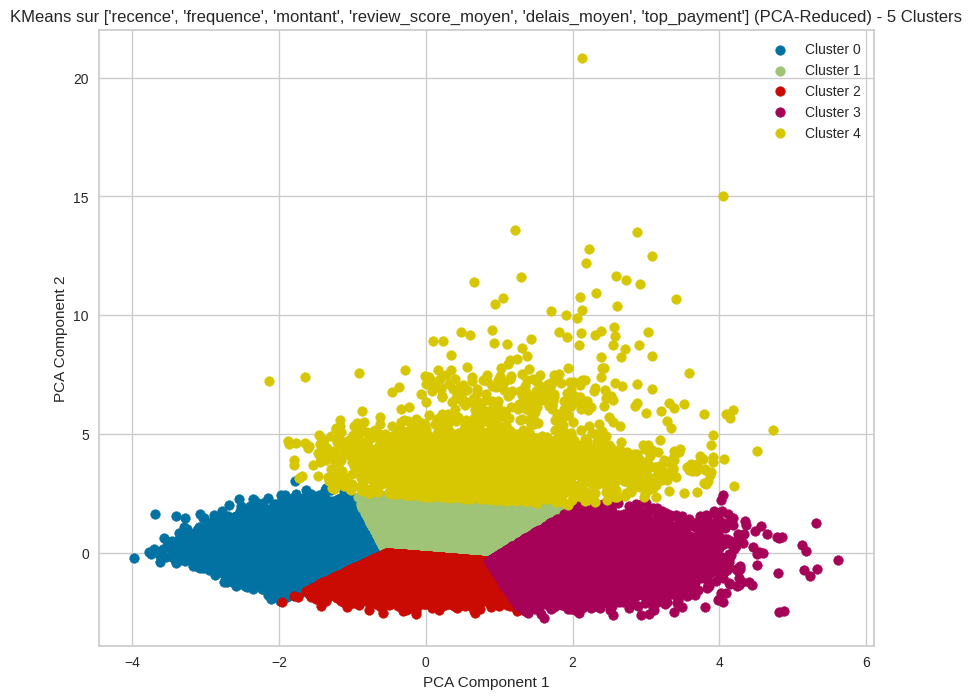

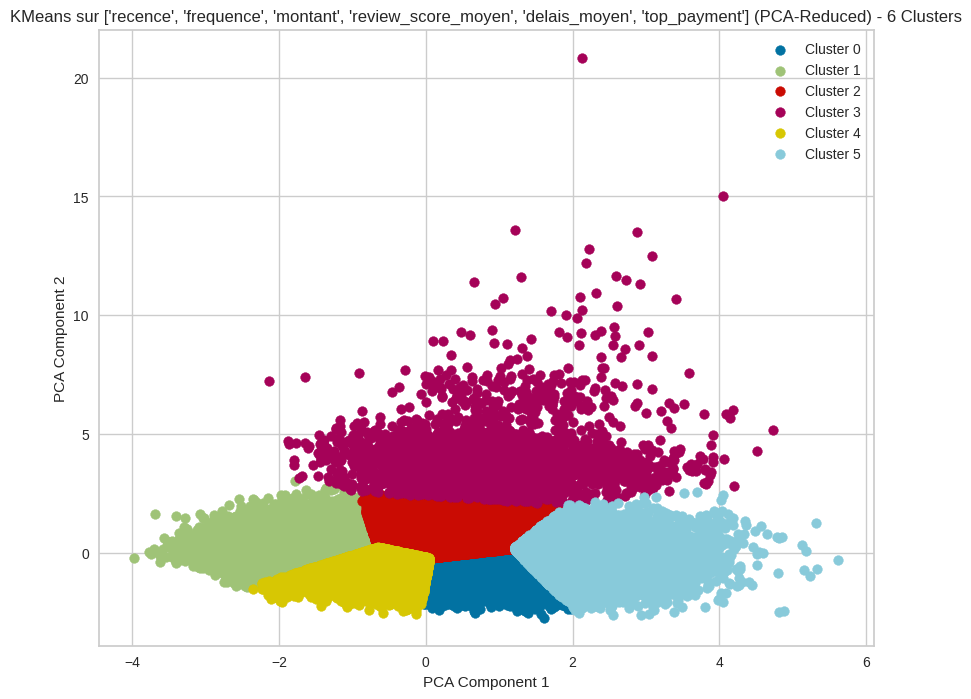

In [149]:
data_rfm_rev_del_pay_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'])

plot_kmeans_PCA_clusters(data_rfm_rev_del_pay_kmeans, data_rfm_rev_del_pay_scaled, [5, 6])

## CONCLUSION KMEANS RFM + review_score_moyen + delai_moyen + top_payment
* les scores et coefficients de silhouette, l'inertie et les représentations graphiques montrent qu'une segmentation, avec ces variables, à 5 clusters est pertinente.
* pour cette configuration de variables, nous allons retenir la segmentation à 5 clusters.

# K-MEANS sur RM + review_score_moyen + delais_moyen + top_payment (SANS fréquence)

In [106]:
data_transfo = pd.read_csv('./FINAL_data_rfm_transform.csv')
data_transfo.info()
display(data_transfo.tail())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92754 entries, 0 to 92753
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   recence                 92754 non-null  int64  
 1   frequence               92754 non-null  int64  
 2   montant                 92754 non-null  float64
 3   review_score_moyen      92754 non-null  float64
 4   delais_moyen            92754 non-null  float64
 5   top_payment             92754 non-null  int64  
 6   log_recence             92754 non-null  float64
 7   log_frequence           92754 non-null  float64
 8   log_montant             92754 non-null  float64
 9   log_review_score_moyen  92754 non-null  float64
 10  log_delais_moyen        92754 non-null  float64
 11  log_top_payment         92754 non-null  float64
dtypes: float64(9), int64(3)
memory usage: 8.5 MB


,recence,frequence,montant,review_score_moyen,delais_moyen,top_payment,log_recence,log_frequence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
92749,447,1,2067.42,5.0,27.514861,1,6.104793,0.693147,7.634540,1.791759,3.350425,0.693147
92750,262,1,84.58,4.0,30.097500,1,5.572154,0.693147,4.449452,1.609438,3.437127,0.693147
92751,568,1,112.46,5.0,14.872083,1,6.343880,0.693147,4.731450,1.791759,2.764562,0.693147
92752,119,1,133.69,5.0,11.858854,1,4.787492,0.693147,4.902976,1.791759,2.554033,0.693147
92753,484,1,71.56,5.0,7.552118,1,6.184149,0.693147,4.284414,1.791759,2.146179,0.693147


In [107]:
data_transfo.log_top_payment.unique()

array([0.69314718, 0.        , 1.38629436, 1.09861229])

## RM + review_score_moyen + delais_moyen + top_payment

In [108]:
data_RM_rev_del_pay = data_transfo.filter(['log_recence', 'log_montant', 'log_review_score_moyen', 'log_delais_moyen', 'log_top_payment'])
data_RM_rev_del_pay.head()

,log_recence,log_montant,log_review_score_moyen,log_delais_moyen,log_top_payment
0,4.718499,4.962145,1.791759,2.002996,0.693147
1,4.744932,3.338967,1.609438,1.455258,0.693147
2,6.287859,4.468434,1.386294,3.285852,0.693147
3,5.774552,3.798182,1.609438,3.046287,0.693147
4,5.666427,5.287711,1.791759,2.649088,0.693147


In [109]:
# Normalisation des données
scaler = StandardScaler()
data_RM_rev_del_pay_scaled = scaler.fit_transform(data_RM_rev_del_pay)

## Nombre de cluster optimal

In [110]:
plot_silhouette_scores(data_RM_rev_del_pay, data_RM_rev_del_pay_scaled, n_clusters_range = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])

Pour n_clusters = 2, le score de silhouette est 0.316
Pour n_clusters = 3, le score de silhouette est 0.283
Pour n_clusters = 4, le score de silhouette est 0.276
Pour n_clusters = 5, le score de silhouette est 0.240
Pour n_clusters = 6, le score de silhouette est 0.226
Pour n_clusters = 7, le score de silhouette est 0.230
Pour n_clusters = 8, le score de silhouette est 0.213
Pour n_clusters = 9, le score de silhouette est 0.207
Pour n_clusters = 10, le score de silhouette est 0.202


### Coefficients de silhouette suivants le nombre de cluster
- Le coefficient de silhouette est une mesure qui évalue la qualité de la séparation des clusters pour chaque point de données individuel. Il est calculé pour chaque point de données et se situe entre -1 et 1
- il permet de regarder dans le détail la compacité de chaque cluster dans une segmentation donnée. le coefficient de silhouette de chaque cluster doit tendre vers 1 pour indiquer une bonne séparation de chaque cluster et donc par extension une bonne qualité de segmentation.



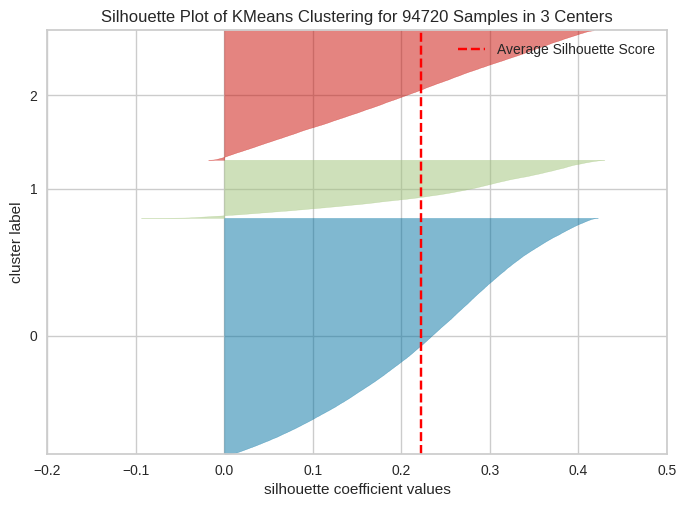

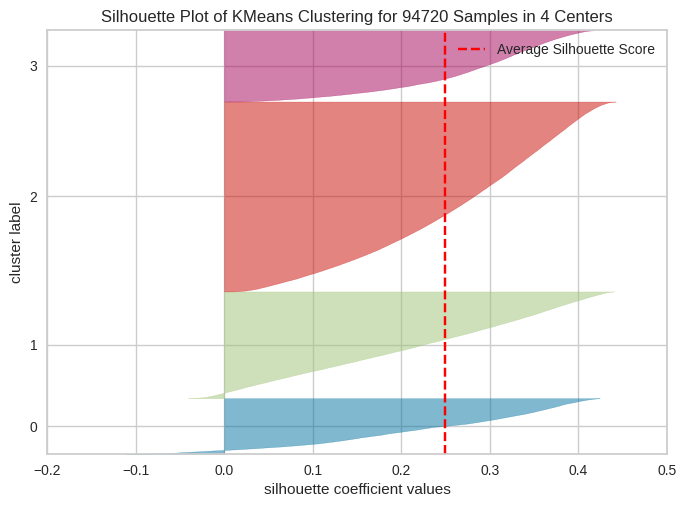

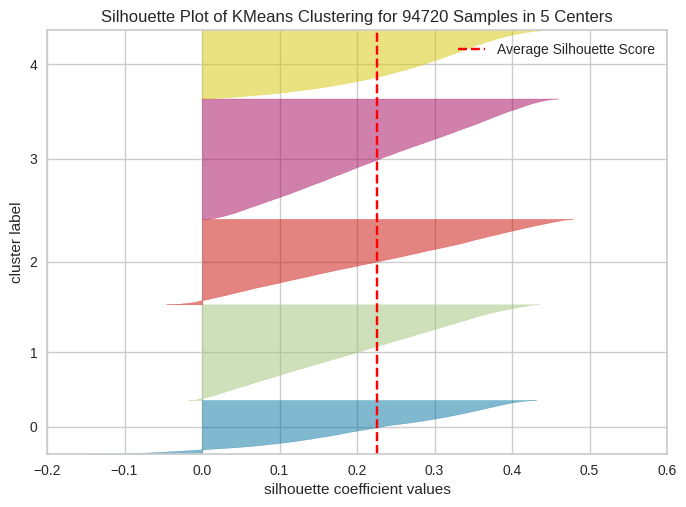

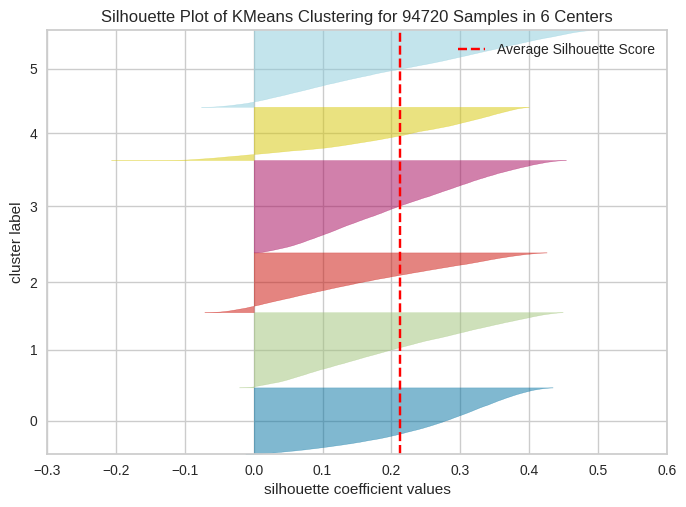

{3: 0.22171884315443458,
 4: 0.24988573438340636,
 5: 0.22624258740241251,
 6: 0.21172953485024737}

In [ ]:
plot_silhouette_coef(data_RM_rev_del_pay, data_RM_rev_del_pay_scaled, k_range=(3, 7))

### Méthode du coude
- tracer la distorsion / inertie en fonction du nombre de clusters (k) pour identifier le "coude" dans la courbe, ce qui indique un bon compromis entre le nombre de clusters et la qualité du clustering. (=faible distorision = les points qui composent les cluster sont proches de leurs centroides respectifs et indique des cluster compacts)

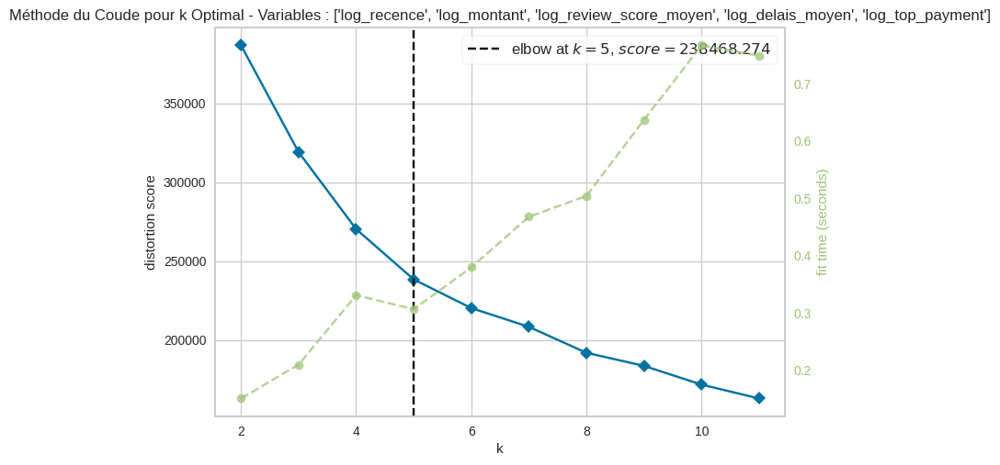

In [ ]:
plot_elbow_method(data_RM_rev_del_pay, data_RM_rev_del_pay_scaled, k_range=(2, 12))

## Réprésentation graphique des clusters 

In [105]:
# init le kmeans avec les 4 clusters
kmeans_RM_rev_del_pay = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_RM_rev_del_pay_kmeans = data_transfo.filter(['recence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'])
data_RM_rev_del_pay_kmeans['cluster'] = kmeans_RM_rev_del_pay.fit_predict(data_RM_rev_del_pay_scaled)
data_RM_rev_del_pay_kmeans.head()

,recence,montant,review_score_moyen,delais_moyen,top_payment,cluster
0,160,141.90,5.0,6.411227,1,1
1,163,27.19,4.0,3.285590,1,1
2,586,86.22,3.0,25.731759,1,2
3,370,43.62,4.0,20.037083,1,2
4,337,196.89,5.0,13.141134,1,2


In [107]:
data_RM_rev_del_pay_kmeans.top_payment.value_counts()

top_payment
1    70894
0    18744
4     3586
2     1495
3        1
Name: count, dtype: int64

In [106]:
data_RM_rev_del_pay_kmeans.cluster.unique()

array([1, 2, 3, 0], dtype=int32)

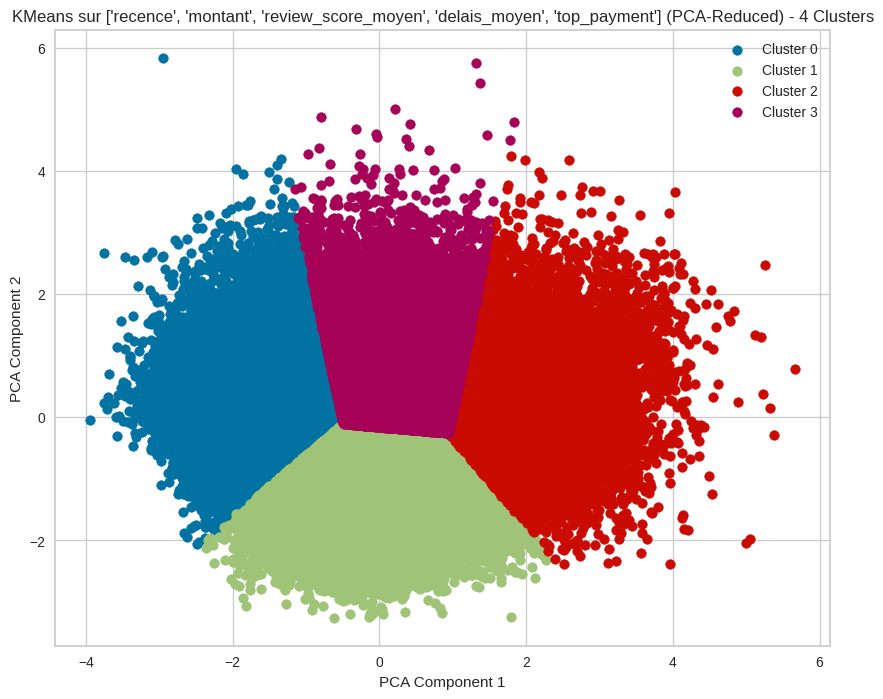

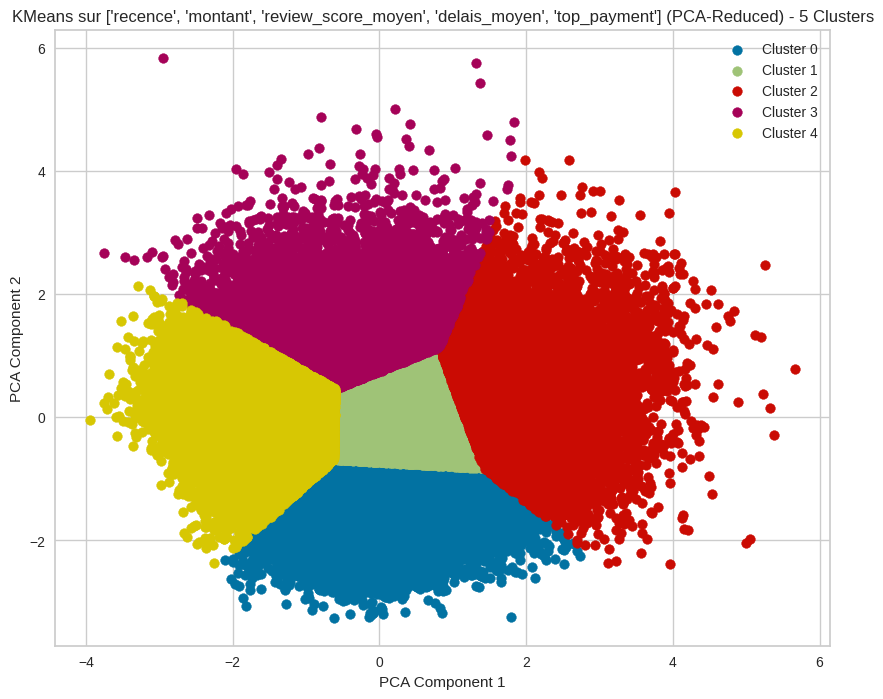

In [161]:
data_RM_rev_del_pay_kmeans = data_transfo.filter(['recence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'])

plot_kmeans_PCA_clusters(data_RM_rev_del_pay_kmeans, data_RM_rev_del_pay_scaled, [4, 5])

## CONCLUSION KMEANS RFM + review_score_moyen + delai_moyen + top_payment
* les scores et coefficients de silhouette et l'intertie indiquent soit une segemntation optimale à 4 ou 5
* les représentations graphiques montrent qu'une segmentation, avec ces variables, à 4 ou 5 clusters est pertinente.
* pour cette configuration de variables, nous allons retenir la segmentation à 4 clusters.

# INTERPRÉTATIONS DES DIFFERENTS CLUSTERINGS
* box plot
* radarplot


In [89]:
correspondance_top_payment = pd.read_csv('./correspondance_top_payment.csv')
correspondance_top_payment

,Encoded,Original
0,0,boleto
1,1,credit_card
2,2,debit_card
3,3,not_defined
4,4,voucher


## FONCTION GRAPHIQUE


In [115]:
### GRAPHIQUE RADARPLOT POUR INTERPRÉTER LES CLUSTERS
def cluster_radar_plot(data, select_columns, min_max=(0, 10)):
    """
    Génère une figure de radar plots pour interpréter les clusters existants.

    Parameters:
    data (pd.DataFrame): Le DataFrame contenant les données originales avec les clusters déjà ajoutés.
    select_columns (list): Liste des colonnes à sélectionner pour l'analyse des clusters.
    min_max (tuple): La plage de valeurs pour la normalisation.
    
    Returns:
    None
    """
    
    scaler = MinMaxScaler(min_max)
    # Calculer le nombre d'individus dans chaque cluster
    cluster_sizes = data['cluster'].value_counts().sort_index()
    
    # isoler la colonne top_payment de la normalisation
    if 'top_payment' in data.columns :
        exclude_column = 'top_payment'
        # Créer une nouvelle liste sans la colonne à exclure
        filtered_columns = [col for col in select_columns if col != exclude_column]
        # Grouper les données quantitatives par cluster et calculer la moyenne pour chaque cluster
        grouped_data_clusters = data.filter(filtered_columns + ['cluster']).groupby('cluster').mean()
        # Grouper les données qualitatives par cluster et récupérer la valeur la plus représentée pour chaque cluster
        grouped_data_clusters_paiement = data.filter(['top_payment'] + ['cluster']).groupby('cluster').agg(lambda x: x.mode().iloc[0])
        # Normaliser les données groupées
        scaled_data = pd.DataFrame(scaler.fit_transform(grouped_data_clusters), columns=grouped_data_clusters.columns)
        # regrouper le dataframe avec la variable catégorielle pour chaque cluster
        scaled_data_paiement_clusters = pd.concat([scaled_data, grouped_data_clusters_paiement], axis=1)

        # radarplots 
        n_clusters = len(grouped_data_clusters)
        kmeans_columns = ', '.join(select_columns)
        subplot_titles = [f'Cluster {i} (Nbre={cluster_sizes[i]})' for i in range(n_clusters)]
        fig = make_subplots(rows=1, cols=n_clusters, subplot_titles=subplot_titles, specs=[[{'type': 'polar'}] * n_clusters], horizontal_spacing=0.1)

        for cluster, row in scaled_data_paiement_clusters.iterrows():
            trace = go.Scatterpolar(r=row.values, theta=row.index, fill='toself', name=f'Cluster {cluster}')
            fig.add_trace(trace, row=1, col=cluster+1)

        # Ajouter une annotation pour expliquer la correspondance des valeurs de catégories de paiement
        annotation_text = " Correspondance type de paiement : 0 = boleto / 1 = credit_card / 2 = debit_card / 3 = not_defined / 4 = voucher"
        fig.add_annotation(
            text=annotation_text,
            xref="paper", yref="paper",
            x=0.5, y=-0.1,
            showarrow=False,
            font=dict(size=12)
        )
        fig.update_layout(
            title_text=f"Radar Plots des clusters -  K-Means à {n_clusters} clusters - Variables: {kmeans_columns}",
            showlegend=False,
            margin=dict(t=100, b=50, l=50, r=50),
            width=1600,  # Largeur de la figure
            height=500   # Hauteur de la figure
        )
        fig.show()
        
        
    else:        
        # Grouper les données par cluster et calculer la moyenne pour chaque cluster
        #print("data.cluster.unique() = ", data.cluster.unique())
        grouped_data_clusters = data.filter(select_columns + ['cluster']).groupby('cluster').mean()
        # Normaliser les données groupées
        scaled_data_clusters = pd.DataFrame(scaler.fit_transform(grouped_data_clusters), columns=grouped_data_clusters.columns)
        
        # radarplots 
        n_clusters = len(grouped_data_clusters)
        #print("n_clusters=", n_clusters)
        
        kmeans_columns = ', '.join(select_columns)
        subplot_titles = [f'Cluster {i} (Nbre={cluster_sizes[i]})' for i in range(n_clusters)]
        fig = make_subplots(rows=1, cols=n_clusters, subplot_titles=subplot_titles, specs=[[{'type': 'polar'}] * n_clusters], horizontal_spacing=0.1)

        for cluster, row in scaled_data_clusters.iterrows():
            trace = go.Scatterpolar(r=row.values, theta=row.index, fill='toself', name=f'Cluster {cluster}')
            fig.add_trace(trace, row=1, col=cluster+1)

        fig.update_layout(
            title_text=f"Radar Plots des clusters -  K-Means à {n_clusters} clusters - Variables: {kmeans_columns}",
            showlegend=False,
            margin=dict(t=100, b=50, l=50, r=50),
            width=1600,  # Largeur de la figure
            height=500   # Hauteur de la figure
        )
        fig.show()


### kmeans sur ['recence', 'frequence', 'montant', 'review_score_moyen'] / 4 clusters


In [86]:
# kmeans sur ['recence', 'frequence', 'montant', 'review_score_moyen'] / 4 clusters
kmeans_rfm_rev = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_rfm_rev_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen'])
data_rfm_rev_kmeans['cluster'] = kmeans_rfm_rev.fit_predict(data_rfm_rev_scaled)
#data_rfm_rev_kmeans.head()

# Sélectionner les colonnes pertinentes pour l'analyse des clusters
select_columns = ['recence', 'frequence', 'montant', 'review_score_moyen']

# Générer les radar plots combinés en utilisant les clusters existants
cluster_radar_plot(data_rfm_rev_kmeans, select_columns)


- **Recence** : Si la valeur est faible, cela signifie que les clients de ce cluster ont effectué des achats récemment.
- **Frequence** : Si la valeur est élevée, cela signifie que les clients de ce cluster ont effectué plus d'un achat.
- **Montant** : Si la valeur est faible (proche de zéro), cela signifie que les clients de ce cluster dépensent peu.
- **Review_score_moyen** : Si la valeur est élevée, cela signifie que les clients de ce cluster donnent de bonnes évaluations.

* CLUSTER 0 (2980 clients): clients moyennement anciens et dépensiers, les seuls à avoir fait plusieurs commandes, satisfaits de leurs commandes = clients fidèles, satisfaits et dépensiers
* CLUSTER 1 (12771 clients): anciens clients, montants en dessous de la moyenne, mais pas satisfait de leurs commande = clients perdus
* CLUSTER 2 (29013 clients): nouveaux clients, sur de petites dépenses mais très satisfaits de leurs achats = nouveaux arrivants à relancer
* CLUSTER 3 (49956 clients): clients les plus anciens et les moins dépensiers de tous, à satisfaction élevée  = clients anciens à relancer

### kmeans sur ['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen'] / 4 clusters


In [87]:
# kmeans sur ['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen'] / 4 clusters
kmeans_rfm_rev_del = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_rfm_rev_del_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen'])
data_rfm_rev_del_kmeans['cluster'] = kmeans_rfm_rev_del.fit_predict(data_rfm_rev_del_scaled)

# Sélectionner les colonnes pertinentes pour l'analyse des clusters
select_columns = ['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen']

# Générer les radar plots combinés en utilisant les clusters existants
cluster_radar_plot(data_rfm_rev_del_kmeans, select_columns)

- **Recence** : Si la valeur est faible, cela signifie que les clients de ce cluster ont effectué des achats récemment.
- **Frequence** : Si la valeur est élevée, cela signifie que les clients de ce cluster ont effectué plus d'un achat.
- **Montant** : Si la valeur est faible (proche de zéro), cela signifie que les clients de ce cluster dépensent peu.
- **Review_score_moyen** : Si la valeur est élevée, cela signifie que les clients de ce cluster donnent de bonnes évaluations.
- **Delais_moyen** : Si la valeur est faible, cela signifie que les délais de livraison pour ce cluster sont courts.


* CLUSTER 0 (51102 clients): clients les plus anciens sur de petits montants, leur délai d'attente de livraison était moyen, et très satisfaits de leur commande = clients anciens à relancer
* CLUSTER 1 (12644 clients): clients moyennement anciens, sur des montants un peu faibles, mais avec un délai d'attente de livraison maximal et insastifaits de leur commande = clienst perdus
* CLUSTER 2 (2980 clients): clients moyennement récents sur des montants très élevés, les seuls à avoir fait plusieurs commandes. leur délai d'attente de livraison reste en dessous de la moyenne et ils sont très satisfaits de leur commande = clients fidèles, satisfaits et dépensiers
* CLUSTER 3 (27994 clients): nouveaux clients, très petites dépenses, délai d'attente de livraison les plus courts, et très satisfaits de leur commande = nouveaux arrivants à relancer

### kmeans sur ['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'] / 5 clusters


In [116]:
# kmeans sur ['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'] / 5 clusters
kmeans_rfm_rev_del_pay = KMeans(n_clusters=5, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_rfm_rev_del_pay_kmeans = data_transfo.filter(['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'])
data_rfm_rev_del_pay_kmeans['cluster'] = kmeans_rfm_rev_del_pay.fit_predict(data_rfm_rev_del_pay_scaled)
# Sélectionner les colonnes pertinentes pour l'analyse des clusters
select_columns = ['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment']

# Générer les radar plots combinés en utilisant les clusters existants
cluster_radar_plot(data_rfm_rev_del_pay_kmeans, select_columns)

- **Recence** : Si la valeur est faible, cela signifie que les clients de ce cluster ont effectué des achats récemment.
- **Frequence** : Si la valeur est élevée, cela signifie que les clients de ce cluster ont effectué plus d'un achat.
- **Montant** : Si la valeur est faible (proche de zéro), cela signifie que les clients de ce cluster dépensent peu.
- **Review_score_moyen** : Si la valeur est élevée, cela signifie que les clients de ce cluster donnent de bonnes évaluations.
- **Delais_moyen** : Si la valeur est faible, cela signifie que les délais de livraison pour ce cluster sont courts.
- **Top_payment** : 0 = boleto / 1 = credit_card / 2 = debit_card / 3 = not_defined / 4 = voucher 

* CLUSTER 0 (41252 clients): majorité de credit_card, clients les plus anciens, satisfaits de leur commande, montant peu importants, délais de livraison moyens = clients anciens à relancer
* CLuSTER 1 (22853 clients): majorité de credit_card, clients très récents, livraisons très rapides, satisfaits de leur commande, très petits montants = nouveaux arrivants à relancer
* CLUSTER 2 (12141 clients): majorité de credit_card, clients assez anciens, délais de livraisons les plus élevés, pas du tout satisfaits de leurs commandes, montants moyens = clients anciens perdus
* CLuSTER 3 (15949 clients): majorité de boleto,  clients assez anciens, délais de livraison moyens, satisfaits de leur commande, très petits montants = clients anciens à relancer
* CLUSTER 4 (2980 clients): majorité de credit_card, clients moyenement anciens, montants les plus élevés, satisfaits de leur commande, délais de livraison moyens, les seuls clients à avoir passé plusieurs commandes = clients fidèles, satisfaits et dépensiers

In [117]:
# kmeans sur ['recence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'] / 4 clusters
kmeans_RM_rev_del_pay = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
# rajouter les clusters pour chaque individus du dataset
data_RM_rev_del_pay_kmeans = data_transfo.filter(['recence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment'])
data_RM_rev_del_pay_kmeans['cluster'] = kmeans_RM_rev_del_pay.fit_predict(data_RM_rev_del_pay_scaled)
# Sélectionner les colonnes pertinentes pour l'analyse des clusters
select_columns = ['recence', 'montant', 'review_score_moyen', 'delais_moyen', 'top_payment']

# Générer les radar plots combinés en utilisant les clusters existants
cluster_radar_plot(data_RM_rev_del_pay_kmeans, select_columns)

- **Recence** : Si la valeur est faible, cela signifie que les clients de ce cluster ont effectué des achats récemment.
- **Montant** : Si la valeur est faible (proche de zéro), cela signifie que les clients de ce cluster dépensent peu.
- **Review_score_moyen** : Si la valeur est élevée, cela signifie que les clients de ce cluster donnent de bonnes évaluations.
- **Delais_moyen** : Si la valeur est faible, cela signifie que les délais de livraison pour ce cluster sont courts.
- **Top_payment** : 0 = boleto / 1 = credit_card / 2 = debit_card / 3 = not_defined / 4 = voucher 

* CLUSTER 0 (12415 clients): majorité de credit_card, clients assez anciens, pas du tout satisfaits de leur commande, montant élevés, délais de livraison élevés = clients perdus
* CLuSTER 1 (23880 clients): majorité de credit_card, clients très récents, livraisons très rapides, satisfaits de leur commande, très petits montants = nouveaux arrivants à relancer
* CLUSTER 2 (42486 clients): majorité de credit_card, clients assez anciens, délais de livraisons moyens, satisfaits de leurs commandes, montants moyens = clients anciens à relancer
* CLuSTER 3 (15949 clients): majorité de boleto,  clients assez anciens, délais de livraison moyens, satisfaits de leur commande, très petits montants = clients anciens à relancer


In [118]:
data_transfo

,recence,frequence,montant,top_payment,review_score_moyen,delais_moyen,log_recence,log_frequence,log_montant,log_top_payment,log_review_score_moyen,log_delais_moyen
0,160,1,141.90,1,5.0,6.411227,5.081404,0.693147,4.962145,0.693147,1.791759,2.002996
1,163,1,27.19,1,4.0,3.285590,5.099866,0.693147,3.338967,0.693147,1.609438,1.455258
2,586,1,86.22,1,3.0,25.731759,6.375025,0.693147,4.468434,0.693147,1.386294,3.285852
3,370,1,43.62,1,4.0,20.037083,5.916202,0.693147,3.798182,0.693147,1.609438,3.046287
4,337,1,196.89,1,5.0,13.141134,5.823046,0.693147,5.287711,0.693147,1.791759,2.649088
...,...,...,...,...,...,...,...,...,...,...,...,...
94715,496,1,2067.42,1,5.0,27.514861,6.208590,0.693147,7.634540,0.693147,1.791759,3.350425
94716,311,1,84.58,1,4.0,30.097500,5.743003,0.693147,4.449452,0.693147,1.609438,3.437127
94717,617,1,112.46,1,5.0,14.872083,6.426488,0.693147,4.731450,0.693147,1.791759,2.764562
94718,168,1,133.69,1,5.0,11.858854,5.129899,0.693147,4.902976,0.693147,1.791759,2.554033


## CONCLUSION INTERPRÉTATION DES CLUSTERS

- L'ajout du moyen de paiement le plus représenté par cluster n'est finalement pas très intéressant. la grande majorité des paiements sont effectués avec des cartes de crédit, puis secondement avec des boletos, l'ajout du moyen de paiement divise simplement en 2 le groupe des "clients anciens à relancer", entre ceux qui payent surtout en carte de crédit et ceux qui payent en boletos. Il faudrait voir avec le service marketing si cette information est pertinente : y'a-t-il des offres, des réductions, des facilités à la commande qui peuvent être différenciées suivant le moyen de paiement ?
- La fréquence d'achat, même si sa répartition est très déséquilibrée (immense majorité de commande unique), permet néanmoins de repérer le petit groupe de clients fidèles et dépensiers très satisfaits de leur commande. des actions marketing ciblées peuvent avoir de belles retombées, malgré la petite taille encore de ce groupe de VIP, qui est voué à croître avec le temps.
- Pour la maintenance du clustering, l'évolution de la fréquence d'achat sera donc déterminante.
- Le clustering à retenir (le plus facilement interprétable et donnant les informations les plus pertinentes) est donc le **kmeans sur ['recence', 'frequence', 'montant', 'review_score_moyen', 'delais_moyen'] en 4 clusters**, qui permet d'identifier les 4 groupes suivants :
    * CLUSTER 0 (51102 clients) = clients anciens à relancer
    * CLUSTER 1 (12644 clients) = clienst perdus
    * CLUSTER 2 (2980 clients) = clients fidèles, satisfaits et dépensiers
    * CLUSTER 3 (27994 clients) = nouveaux arrivants à relancer
- ce clustering permets d'identifier notament l'impact du délai de livraison sur la fidélisation des clients, et d'identifier que les montants élevés des achats ne sont pas nécessairement un frein à celle-ci.

